# Afriat

In [1]:
scan=0.12

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: a64w3hxp
Name: forgotten-master-118
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/a64w3hxp
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-a64w3hxp/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2578,3289,9376
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2578,2557,1674,3439,1651,3344
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4477,10766
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 627,820,2363
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 627,645,434,851,398,855
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1107,2703
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:10:29, 13.07s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:10:29, 13.07s/it, v_num=xp_1, total_loss_train=3.73e+3, kl_local_train=53.7]

Epoch 2/600:   0%|          | 1/600 [00:13<2:10:29, 13.07s/it, v_num=xp_1, total_loss_train=3.73e+3, kl_local_train=53.7]

Epoch 2/600:   0%|          | 2/600 [00:24<2:03:29, 12.39s/it, v_num=xp_1, total_loss_train=3.73e+3, kl_local_train=53.7]

Epoch 2/600:   0%|          | 2/600 [00:24<2:03:29, 12.39s/it, v_num=xp_1, total_loss_train=3.23e+3, kl_local_train=86.2]

Epoch 3/600:   0%|          | 2/600 [00:25<2:03:29, 12.39s/it, v_num=xp_1, total_loss_train=3.23e+3, kl_local_train=86.2]

Epoch 3/600:   0%|          | 3/600 [00:36<2:00:22, 12.10s/it, v_num=xp_1, total_loss_train=3.23e+3, kl_local_train=86.2]

Epoch 3/600:   0%|          | 3/600 [00:36<2:00:22, 12.10s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=88.8]

Epoch 4/600:   0%|          | 3/600 [00:36<2:00:22, 12.10s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=88.8]

Epoch 4/600:   1%|          | 4/600 [00:48<1:58:53, 11.97s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=88.8]

Epoch 4/600:   1%|          | 4/600 [00:48<1:58:53, 11.97s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=85.1]

Epoch 5/600:   1%|          | 4/600 [00:48<1:58:53, 11.97s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=85.1]

Epoch 5/600:   1%|          | 5/600 [01:00<1:59:29, 12.05s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=85.1]

Epoch 5/600:   1%|          | 5/600 [01:00<1:59:29, 12.05s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=77.4]

Epoch 6/600:   1%|          | 5/600 [01:01<1:59:29, 12.05s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=77.4]

Epoch 6/600:   1%|          | 6/600 [01:13<2:01:33, 12.28s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=77.4]

Epoch 6/600:   1%|          | 6/600 [01:13<2:01:33, 12.28s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=66.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:13<2:01:33, 12.28s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=66.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:25<1:59:15, 12.07s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=66.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:25<1:59:15, 12.07s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:25<1:59:15, 12.07s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:36<1:57:33, 11.92s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:36<1:57:33, 11.92s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=32.7, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:36<1:57:33, 11.92s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=32.7, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:48<1:56:13, 11.80s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=32.7, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:48<1:56:13, 11.80s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=25.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 9/600 [01:48<1:56:13, 11.80s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=25.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [01:59<1:55:21, 11.73s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=25.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [01:59<1:55:21, 11.73s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=24, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]  

Epoch 11/600:   2%|▏         | 10/600 [02:01<1:55:21, 11.73s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=24, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:12<1:58:25, 12.06s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=24, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00732, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:12<1:58:25, 12.06s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=30.1, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 12/600:   2%|▏         | 11/600 [02:12<1:58:25, 12.06s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=30.1, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 12/600:   2%|▏         | 12/600 [02:24<1:56:40, 11.91s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=30.1, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 12/600:   2%|▏         | 12/600 [02:24<1:56:40, 11.91s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 13/600:   2%|▏         | 12/600 [02:24<1:56:40, 11.91s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 13/600:   2%|▏         | 13/600 [02:35<1:55:24, 11.80s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 13/600:   2%|▏         | 13/600 [02:35<1:55:24, 11.80s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=45, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]  

Epoch 14/600:   2%|▏         | 13/600 [02:35<1:55:24, 11.80s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=45, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 14/600:   2%|▏         | 14/600 [02:47<1:54:20, 11.71s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=45, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 14/600:   2%|▏         | 14/600 [02:47<1:54:20, 11.71s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 15/600:   2%|▏         | 14/600 [02:47<1:54:20, 11.71s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 15/600:   2%|▎         | 15/600 [02:58<1:53:42, 11.66s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 15/600:   2%|▎         | 15/600 [02:58<1:53:42, 11.66s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 16/600:   2%|▎         | 15/600 [02:59<1:53:42, 11.66s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 16/600:   3%|▎         | 16/600 [03:11<1:56:53, 12.01s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0228, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0422]

Epoch 16/600:   3%|▎         | 16/600 [03:11<1:56:53, 12.01s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=54, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]  

Epoch 17/600:   3%|▎         | 16/600 [03:11<1:56:53, 12.01s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=54, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 17/600:   3%|▎         | 17/600 [03:23<1:55:18, 11.87s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=54, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 17/600:   3%|▎         | 17/600 [03:23<1:55:18, 11.87s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 18/600:   3%|▎         | 17/600 [03:23<1:55:18, 11.87s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 18/600:   3%|▎         | 18/600 [03:34<1:54:03, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 18/600:   3%|▎         | 18/600 [03:34<1:54:03, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=60.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 19/600:   3%|▎         | 18/600 [03:34<1:54:03, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=60.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 19/600:   3%|▎         | 19/600 [03:46<1:53:02, 11.67s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=60.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 19/600:   3%|▎         | 19/600 [03:46<1:53:02, 11.67s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=67.7, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 20/600:   3%|▎         | 19/600 [03:46<1:53:02, 11.67s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=67.7, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 20/600:   3%|▎         | 20/600 [03:57<1:52:25, 11.63s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=67.7, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 20/600:   3%|▎         | 20/600 [03:57<1:52:25, 11.63s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 21/600:   3%|▎         | 20/600 [03:58<1:52:25, 11.63s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 21/600:   4%|▎         | 21/600 [04:10<1:55:33, 11.97s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0606]

Epoch 21/600:   4%|▎         | 21/600 [04:10<1:55:33, 11.97s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=79.9, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 22/600:   4%|▎         | 21/600 [04:10<1:55:33, 11.97s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=79.9, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 22/600:   4%|▎         | 22/600 [04:21<1:54:07, 11.85s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=79.9, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 22/600:   4%|▎         | 22/600 [04:21<1:54:07, 11.85s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 23/600:   4%|▎         | 22/600 [04:21<1:54:07, 11.85s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 23/600:   4%|▍         | 23/600 [04:33<1:53:00, 11.75s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 23/600:   4%|▍         | 23/600 [04:33<1:53:00, 11.75s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=90.4, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 24/600:   4%|▍         | 23/600 [04:33<1:53:00, 11.75s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=90.4, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 24/600:   4%|▍         | 24/600 [04:44<1:52:11, 11.69s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=90.4, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 24/600:   4%|▍         | 24/600 [04:44<1:52:11, 11.69s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=97, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]  

Epoch 25/600:   4%|▍         | 24/600 [04:45<1:52:11, 11.69s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=97, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 25/600:   4%|▍         | 25/600 [04:56<1:51:46, 11.66s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=97, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 25/600:   4%|▍         | 25/600 [04:56<1:51:46, 11.66s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 26/600:   4%|▍         | 25/600 [04:57<1:51:46, 11.66s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 26/600:   4%|▍         | 26/600 [05:09<1:54:49, 12.00s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0835]

Epoch 26/600:   4%|▍         | 26/600 [05:09<1:54:49, 12.00s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 27/600:   4%|▍         | 26/600 [05:09<1:54:49, 12.00s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 27/600:   4%|▍         | 27/600 [05:20<1:53:15, 11.86s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 27/600:   4%|▍         | 27/600 [05:20<1:53:15, 11.86s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 28/600:   4%|▍         | 27/600 [05:20<1:53:15, 11.86s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 28/600:   5%|▍         | 28/600 [05:32<1:52:05, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 28/600:   5%|▍         | 28/600 [05:32<1:52:05, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 29/600:   5%|▍         | 28/600 [05:32<1:52:05, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 29/600:   5%|▍         | 29/600 [05:43<1:51:13, 11.69s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 29/600:   5%|▍         | 29/600 [05:43<1:51:13, 11.69s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 30/600:   5%|▍         | 29/600 [05:43<1:51:13, 11.69s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 30/600:   5%|▌         | 30/600 [05:55<1:50:44, 11.66s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=120, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 30/600:   5%|▌         | 30/600 [05:55<1:50:44, 11.66s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 31/600:   5%|▌         | 30/600 [05:56<1:50:44, 11.66s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 31/600:   5%|▌         | 31/600 [06:08<1:53:44, 11.99s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0998]

Epoch 31/600:   5%|▌         | 31/600 [06:08<1:53:44, 11.99s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]   

Epoch 32/600:   5%|▌         | 31/600 [06:08<1:53:44, 11.99s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 32/600:   5%|▌         | 32/600 [06:19<1:52:19, 11.87s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 32/600:   5%|▌         | 32/600 [06:19<1:52:19, 11.87s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 33/600:   5%|▌         | 32/600 [06:19<1:52:19, 11.87s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 33/600:   6%|▌         | 33/600 [06:31<1:51:15, 11.77s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 33/600:   6%|▌         | 33/600 [06:31<1:51:15, 11.77s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 34/600:   6%|▌         | 33/600 [06:31<1:51:15, 11.77s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 34/600:   6%|▌         | 34/600 [06:42<1:50:24, 11.70s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 34/600:   6%|▌         | 34/600 [06:42<1:50:24, 11.70s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107] 

Epoch 35/600:   6%|▌         | 34/600 [06:43<1:50:24, 11.70s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 35/600:   6%|▌         | 35/600 [06:54<1:50:20, 11.72s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 35/600:   6%|▌         | 35/600 [06:54<1:50:20, 11.72s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 36/600:   6%|▌         | 35/600 [06:55<1:50:20, 11.72s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 36/600:   6%|▌         | 36/600 [07:07<1:53:14, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.107]

Epoch 36/600:   6%|▌         | 36/600 [07:07<1:53:14, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=97.1, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 37/600:   6%|▌         | 36/600 [07:07<1:53:14, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=97.1, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 37/600:   6%|▌         | 37/600 [07:19<1:51:34, 11.89s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=97.1, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 37/600:   6%|▌         | 37/600 [07:19<1:51:34, 11.89s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 38/600:   6%|▌         | 37/600 [07:19<1:51:34, 11.89s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 38/600:   6%|▋         | 38/600 [07:30<1:50:31, 11.80s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 38/600:   6%|▋         | 38/600 [07:30<1:50:31, 11.80s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 39/600:   6%|▋         | 38/600 [07:30<1:50:31, 11.80s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 39/600:   6%|▋         | 39/600 [07:42<1:49:38, 11.73s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 39/600:   6%|▋         | 39/600 [07:42<1:49:38, 11.73s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 40/600:   6%|▋         | 39/600 [07:42<1:49:38, 11.73s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 40/600:   7%|▋         | 40/600 [07:53<1:48:56, 11.67s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 40/600:   7%|▋         | 40/600 [07:53<1:48:56, 11.67s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 41/600:   7%|▋         | 40/600 [07:55<1:48:56, 11.67s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 41/600:   7%|▋         | 41/600 [08:06<1:52:03, 12.03s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 41/600:   7%|▋         | 41/600 [08:06<1:52:03, 12.03s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 42/600:   7%|▋         | 41/600 [08:06<1:52:03, 12.03s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 42/600:   7%|▋         | 42/600 [08:18<1:50:31, 11.88s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 42/600:   7%|▋         | 42/600 [08:18<1:50:31, 11.88s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 43/600:   7%|▋         | 42/600 [08:18<1:50:31, 11.88s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 43/600:   7%|▋         | 43/600 [08:29<1:49:31, 11.80s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 43/600:   7%|▋         | 43/600 [08:29<1:49:31, 11.80s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 44/600:   7%|▋         | 43/600 [08:29<1:49:31, 11.80s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 44/600:   7%|▋         | 44/600 [08:41<1:48:45, 11.74s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 44/600:   7%|▋         | 44/600 [08:41<1:48:45, 11.74s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=93, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]  

Epoch 45/600:   7%|▋         | 44/600 [08:41<1:48:45, 11.74s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=93, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 45/600:   8%|▊         | 45/600 [08:52<1:48:07, 11.69s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=93, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 45/600:   8%|▊         | 45/600 [08:52<1:48:07, 11.69s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 46/600:   8%|▊         | 45/600 [08:54<1:48:07, 11.69s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 46/600:   8%|▊         | 46/600 [09:05<1:51:10, 12.04s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.112]

Epoch 46/600:   8%|▊         | 46/600 [09:05<1:51:10, 12.04s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115] 

Epoch 47/600:   8%|▊         | 46/600 [09:05<1:51:10, 12.04s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 47/600:   8%|▊         | 47/600 [09:17<1:49:59, 11.93s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 47/600:   8%|▊         | 47/600 [09:17<1:49:59, 11.93s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 48/600:   8%|▊         | 47/600 [09:17<1:49:59, 11.93s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 48/600:   8%|▊         | 48/600 [09:29<1:48:49, 11.83s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 48/600:   8%|▊         | 48/600 [09:29<1:48:49, 11.83s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 49/600:   8%|▊         | 48/600 [09:29<1:48:49, 11.83s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 49/600:   8%|▊         | 49/600 [09:40<1:48:16, 11.79s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 49/600:   8%|▊         | 49/600 [09:40<1:48:16, 11.79s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 50/600:   8%|▊         | 49/600 [09:40<1:48:16, 11.79s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 50/600:   8%|▊         | 50/600 [09:52<1:47:33, 11.73s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 50/600:   8%|▊         | 50/600 [09:52<1:47:33, 11.73s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=94, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]  

Epoch 51/600:   8%|▊         | 50/600 [09:53<1:47:33, 11.73s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=94, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 51/600:   8%|▊         | 51/600 [10:05<1:50:35, 12.09s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=94, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 51/600:   8%|▊         | 51/600 [10:05<1:50:35, 12.09s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 52/600:   8%|▊         | 51/600 [10:05<1:50:35, 12.09s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 52/600:   9%|▊         | 52/600 [10:16<1:49:05, 11.94s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=93.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 52/600:   9%|▊         | 52/600 [10:16<1:49:05, 11.94s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=91.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 53/600:   9%|▊         | 52/600 [10:16<1:49:05, 11.94s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=91.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 53/600:   9%|▉         | 53/600 [10:28<1:47:57, 11.84s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=91.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 53/600:   9%|▉         | 53/600 [10:28<1:47:57, 11.84s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 54/600:   9%|▉         | 53/600 [10:28<1:47:57, 11.84s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 54/600:   9%|▉         | 54/600 [10:40<1:47:00, 11.76s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 54/600:   9%|▉         | 54/600 [10:40<1:47:00, 11.76s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]  

Epoch 55/600:   9%|▉         | 54/600 [10:40<1:47:00, 11.76s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 55/600:   9%|▉         | 55/600 [10:51<1:46:19, 11.71s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=92, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 55/600:   9%|▉         | 55/600 [10:51<1:46:19, 11.71s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=89.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 56/600:   9%|▉         | 55/600 [10:52<1:46:19, 11.71s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=89.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 56/600:   9%|▉         | 56/600 [11:04<1:49:16, 12.05s/it, v_num=xp_1, total_loss_train=3.22e+3, kl_local_train=89.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 56/600:   9%|▉         | 56/600 [11:04<1:49:16, 12.05s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=89.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117] 

Epoch 57/600:   9%|▉         | 56/600 [11:04<1:49:16, 12.05s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=89.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 57/600:  10%|▉         | 57/600 [11:16<1:47:53, 11.92s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=89.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 57/600:  10%|▉         | 57/600 [11:16<1:47:53, 11.92s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 57/600 [11:16<1:47:53, 11.92s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 58/600 [11:27<1:46:53, 11.83s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 58/600 [11:27<1:46:53, 11.83s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=88.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 58/600 [11:27<1:46:53, 11.83s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=88.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 59/600 [11:39<1:45:58, 11.75s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=88.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 59/600 [11:39<1:45:58, 11.75s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=86.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|▉         | 59/600 [11:39<1:45:58, 11.75s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=86.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|█         | 60/600 [11:50<1:45:17, 11.70s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=86.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|█         | 60/600 [11:50<1:45:17, 11.70s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=86.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 60/600 [11:52<1:45:17, 11.70s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=86.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 61/600 [12:03<1:48:17, 12.05s/it, v_num=xp_1, total_loss_train=3.21e+3, kl_local_train=86.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 61/600 [12:03<1:48:17, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 62/600:  10%|█         | 61/600 [12:03<1:48:17, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 62/600:  10%|█         | 62/600 [12:15<1:47:00, 11.93s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 62/600:  10%|█         | 62/600 [12:15<1:47:00, 11.93s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 63/600:  10%|█         | 62/600 [12:15<1:47:00, 11.93s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 63/600:  10%|█         | 63/600 [12:27<1:45:59, 11.84s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 63/600:  10%|█         | 63/600 [12:27<1:45:59, 11.84s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]  

Epoch 64/600:  10%|█         | 63/600 [12:27<1:45:59, 11.84s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 64/600:  11%|█         | 64/600 [12:38<1:45:14, 11.78s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=84, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 64/600:  11%|█         | 64/600 [12:38<1:45:14, 11.78s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=82.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 65/600:  11%|█         | 64/600 [12:38<1:45:14, 11.78s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=82.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 65/600:  11%|█         | 65/600 [12:50<1:44:23, 11.71s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=82.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 65/600:  11%|█         | 65/600 [12:50<1:44:23, 11.71s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=82.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 66/600:  11%|█         | 65/600 [12:51<1:44:23, 11.71s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=82.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 66/600:  11%|█         | 66/600 [13:03<1:47:16, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=82.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 66/600:  11%|█         | 66/600 [13:03<1:47:16, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112] 

Epoch 67/600:  11%|█         | 66/600 [13:03<1:47:16, 12.05s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 67/600:  11%|█         | 67/600 [13:14<1:45:55, 11.92s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 67/600:  11%|█         | 67/600 [13:14<1:45:55, 11.92s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=80.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 68/600:  11%|█         | 67/600 [13:14<1:45:55, 11.92s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=80.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 68/600:  11%|█▏        | 68/600 [13:26<1:44:54, 11.83s/it, v_num=xp_1, total_loss_train=3.2e+3, kl_local_train=80.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 68/600:  11%|█▏        | 68/600 [13:26<1:44:54, 11.83s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=79.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 69/600:  11%|█▏        | 68/600 [13:26<1:44:54, 11.83s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=79.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 69/600:  12%|█▏        | 69/600 [13:37<1:44:05, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=79.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 69/600:  12%|█▏        | 69/600 [13:37<1:44:05, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=80.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 70/600:  12%|█▏        | 69/600 [13:37<1:44:05, 11.76s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=80.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 70/600:  12%|█▏        | 70/600 [13:49<1:43:22, 11.70s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=80.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 70/600:  12%|█▏        | 70/600 [13:49<1:43:22, 11.70s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 71/600:  12%|█▏        | 70/600 [13:50<1:43:22, 11.70s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 71/600:  12%|█▏        | 71/600 [14:02<1:46:17, 12.06s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 71/600:  12%|█▏        | 71/600 [14:02<1:46:17, 12.06s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 72/600:  12%|█▏        | 71/600 [14:02<1:46:17, 12.06s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 72/600:  12%|█▏        | 72/600 [14:14<1:45:05, 11.94s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 72/600:  12%|█▏        | 72/600 [14:14<1:45:05, 11.94s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 73/600:  12%|█▏        | 72/600 [14:14<1:45:05, 11.94s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 73/600:  12%|█▏        | 73/600 [14:25<1:44:12, 11.86s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=78.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 73/600:  12%|█▏        | 73/600 [14:25<1:44:12, 11.86s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=77.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 74/600:  12%|█▏        | 73/600 [14:25<1:44:12, 11.86s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=77.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 74/600:  12%|█▏        | 74/600 [14:37<1:43:32, 11.81s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=77.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 74/600:  12%|█▏        | 74/600 [14:37<1:43:32, 11.81s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=77.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 75/600:  12%|█▏        | 74/600 [14:37<1:43:32, 11.81s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=77.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 75/600:  12%|█▎        | 75/600 [14:49<1:43:11, 11.79s/it, v_num=xp_1, total_loss_train=3.19e+3, kl_local_train=77.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 75/600:  12%|█▎        | 75/600 [14:49<1:43:11, 11.79s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=76.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 76/600:  12%|█▎        | 75/600 [14:50<1:43:11, 11.79s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=76.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 76/600:  13%|█▎        | 76/600 [15:02<1:46:20, 12.18s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=76.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 76/600:  13%|█▎        | 76/600 [15:02<1:46:20, 12.18s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=76.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 77/600:  13%|█▎        | 76/600 [15:02<1:46:20, 12.18s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=76.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 77/600:  13%|█▎        | 77/600 [15:13<1:44:44, 12.02s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=76.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 77/600:  13%|█▎        | 77/600 [15:13<1:44:44, 12.02s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 78/600:  13%|█▎        | 77/600 [15:13<1:44:44, 12.02s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 78/600:  13%|█▎        | 78/600 [15:25<1:43:33, 11.90s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 78/600:  13%|█▎        | 78/600 [15:25<1:43:33, 11.90s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 79/600:  13%|█▎        | 78/600 [15:25<1:43:33, 11.90s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 79/600:  13%|█▎        | 79/600 [15:37<1:42:38, 11.82s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 79/600:  13%|█▎        | 79/600 [15:37<1:42:38, 11.82s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 80/600:  13%|█▎        | 79/600 [15:37<1:42:38, 11.82s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 80/600:  13%|█▎        | 80/600 [15:48<1:41:52, 11.76s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=75.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 80/600:  13%|█▎        | 80/600 [15:48<1:41:52, 11.76s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 81/600:  13%|█▎        | 80/600 [15:50<1:41:52, 11.76s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 81/600:  14%|█▎        | 81/600 [16:01<1:44:29, 12.08s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 81/600:  14%|█▎        | 81/600 [16:01<1:44:29, 12.08s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 81/600 [16:01<1:44:29, 12.08s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 82/600 [16:13<1:43:07, 11.95s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 82/600 [16:13<1:43:07, 11.95s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▎        | 82/600 [16:13<1:43:07, 11.95s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▍        | 83/600 [16:24<1:42:09, 11.86s/it, v_num=xp_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▍        | 83/600 [16:24<1:42:09, 11.86s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=73.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 83/600 [16:24<1:42:09, 11.86s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=73.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 84/600 [16:36<1:41:25, 11.79s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=73.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 84/600 [16:36<1:41:25, 11.79s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 84/600 [16:36<1:41:25, 11.79s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 85/600 [16:48<1:40:40, 11.73s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 85/600 [16:48<1:40:40, 11.73s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 85/600 [16:49<1:40:40, 11.73s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 86/600 [17:00<1:43:26, 12.07s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 86/600 [17:00<1:43:26, 12.07s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 87/600:  14%|█▍        | 86/600 [17:00<1:43:26, 12.07s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 87/600:  14%|█▍        | 87/600 [17:12<1:41:55, 11.92s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 87/600:  14%|█▍        | 87/600 [17:12<1:41:55, 11.92s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]  

Epoch 88/600:  14%|█▍        | 87/600 [17:12<1:41:55, 11.92s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 88/600:  15%|█▍        | 88/600 [17:24<1:41:01, 11.84s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=72, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 88/600:  15%|█▍        | 88/600 [17:24<1:41:01, 11.84s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 89/600:  15%|█▍        | 88/600 [17:24<1:41:01, 11.84s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 89/600:  15%|█▍        | 89/600 [17:35<1:40:17, 11.78s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 89/600:  15%|█▍        | 89/600 [17:35<1:40:17, 11.78s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 90/600:  15%|█▍        | 89/600 [17:35<1:40:17, 11.78s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 90/600:  15%|█▌        | 90/600 [17:47<1:39:37, 11.72s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 90/600:  15%|█▌        | 90/600 [17:47<1:39:37, 11.72s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]  

Epoch 91/600:  15%|█▌        | 90/600 [17:48<1:39:37, 11.72s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 91/600:  15%|█▌        | 91/600 [18:00<1:42:26, 12.07s/it, v_num=xp_1, total_loss_train=3.17e+3, kl_local_train=71, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 91/600:  15%|█▌        | 91/600 [18:00<1:42:26, 12.07s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 92/600:  15%|█▌        | 91/600 [18:00<1:42:26, 12.07s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 92/600:  15%|█▌        | 92/600 [18:11<1:41:02, 11.93s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 92/600:  15%|█▌        | 92/600 [18:11<1:41:02, 11.93s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 93/600:  15%|█▌        | 92/600 [18:11<1:41:02, 11.93s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 93/600:  16%|█▌        | 93/600 [18:23<1:40:03, 11.84s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 93/600:  16%|█▌        | 93/600 [18:23<1:40:03, 11.84s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 94/600:  16%|█▌        | 93/600 [18:23<1:40:03, 11.84s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 94/600:  16%|█▌        | 94/600 [18:35<1:39:19, 11.78s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=70.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 94/600:  16%|█▌        | 94/600 [18:35<1:39:19, 11.78s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 95/600:  16%|█▌        | 94/600 [18:35<1:39:19, 11.78s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 95/600:  16%|█▌        | 95/600 [18:46<1:38:38, 11.72s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 95/600:  16%|█▌        | 95/600 [18:46<1:38:38, 11.72s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 96/600:  16%|█▌        | 95/600 [18:48<1:38:38, 11.72s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 96/600:  16%|█▌        | 96/600 [18:59<1:41:21, 12.07s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 96/600:  16%|█▌        | 96/600 [18:59<1:41:21, 12.07s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111] 

Epoch 97/600:  16%|█▌        | 96/600 [18:59<1:41:21, 12.07s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [19:11<1:40:05, 11.94s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [19:11<1:40:05, 11.94s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▌        | 97/600 [19:11<1:40:05, 11.94s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [19:22<1:39:03, 11.84s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [19:22<1:39:03, 11.84s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=68.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 98/600 [19:22<1:39:03, 11.84s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=68.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [19:34<1:38:22, 11.78s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=68.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [19:34<1:38:22, 11.78s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  16%|█▋        | 99/600 [19:34<1:38:22, 11.78s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [19:46<1:37:48, 11.74s/it, v_num=xp_1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [19:46<1:37:48, 11.74s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]  

Epoch 101/600:  17%|█▋        | 100/600 [19:47<1:37:48, 11.74s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [19:59<1:40:54, 12.13s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [19:59<1:40:54, 12.13s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 101/600 [19:59<1:40:54, 12.13s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [20:10<1:39:36, 12.00s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [20:10<1:39:36, 12.00s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 102/600 [20:10<1:39:36, 12.00s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [20:22<1:38:32, 11.90s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [20:22<1:38:32, 11.90s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 103/600 [20:22<1:38:32, 11.90s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [20:34<1:37:44, 11.82s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [20:34<1:37:44, 11.82s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  17%|█▋        | 104/600 [20:34<1:37:44, 11.82s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [20:45<1:36:58, 11.75s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [20:45<1:36:58, 11.75s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 105/600 [20:47<1:36:58, 11.75s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [20:58<1:39:36, 12.10s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [20:58<1:39:36, 12.10s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 107/600:  18%|█▊        | 106/600 [20:58<1:39:36, 12.10s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 107/600:  18%|█▊        | 107/600 [21:10<1:38:22, 11.97s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 107/600:  18%|█▊        | 107/600 [21:10<1:38:22, 11.97s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=65.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 108/600:  18%|█▊        | 107/600 [21:10<1:38:22, 11.97s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=65.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 108/600:  18%|█▊        | 108/600 [21:22<1:37:26, 11.88s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=65.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 108/600:  18%|█▊        | 108/600 [21:22<1:37:26, 11.88s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]  

Epoch 109/600:  18%|█▊        | 108/600 [21:22<1:37:26, 11.88s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 109/600:  18%|█▊        | 109/600 [21:33<1:36:36, 11.81s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=66, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 109/600:  18%|█▊        | 109/600 [21:33<1:36:36, 11.81s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 110/600:  18%|█▊        | 109/600 [21:33<1:36:36, 11.81s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 110/600:  18%|█▊        | 110/600 [21:45<1:35:57, 11.75s/it, v_num=xp_1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 110/600:  18%|█▊        | 110/600 [21:45<1:35:57, 11.75s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 111/600:  18%|█▊        | 110/600 [21:46<1:35:57, 11.75s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 111/600:  18%|█▊        | 111/600 [21:58<1:38:37, 12.10s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 111/600:  18%|█▊        | 111/600 [21:58<1:38:37, 12.10s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 112/600:  18%|█▊        | 111/600 [21:58<1:38:37, 12.10s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [22:09<1:37:22, 11.97s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [22:09<1:37:22, 11.97s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▊        | 112/600 [22:09<1:37:22, 11.97s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [22:21<1:36:23, 11.88s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [22:21<1:36:23, 11.88s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 113/600 [22:21<1:36:23, 11.88s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [22:33<1:35:35, 11.80s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [22:33<1:35:35, 11.80s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 114/600 [22:33<1:35:35, 11.80s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [22:44<1:34:53, 11.74s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [22:44<1:34:53, 11.74s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 115/600 [22:46<1:34:53, 11.74s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [22:57<1:37:24, 12.08s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [22:57<1:37:24, 12.08s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 117/600:  19%|█▉        | 116/600 [22:57<1:37:24, 12.08s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 117/600:  20%|█▉        | 117/600 [23:09<1:36:07, 11.94s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 117/600:  20%|█▉        | 117/600 [23:09<1:36:07, 11.94s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]  

Epoch 118/600:  20%|█▉        | 117/600 [23:09<1:36:07, 11.94s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 118/600:  20%|█▉        | 118/600 [23:20<1:35:07, 11.84s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=64, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 118/600:  20%|█▉        | 118/600 [23:20<1:35:07, 11.84s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=63.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 119/600:  20%|█▉        | 118/600 [23:20<1:35:07, 11.84s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=63.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 119/600:  20%|█▉        | 119/600 [23:32<1:34:18, 11.76s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=63.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 119/600:  20%|█▉        | 119/600 [23:32<1:34:18, 11.76s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=63.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 120/600:  20%|█▉        | 119/600 [23:32<1:34:18, 11.76s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=63.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 120/600:  20%|██        | 120/600 [23:43<1:33:33, 11.69s/it, v_num=xp_1, total_loss_train=3.14e+3, kl_local_train=63.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 120/600:  20%|██        | 120/600 [23:43<1:33:33, 11.69s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 121/600:  20%|██        | 120/600 [23:45<1:33:33, 11.69s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 121/600:  20%|██        | 121/600 [23:56<1:36:13, 12.05s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 121/600:  20%|██        | 121/600 [23:56<1:36:13, 12.05s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102] 

Epoch 122/600:  20%|██        | 121/600 [23:56<1:36:13, 12.05s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [24:08<1:35:01, 11.93s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [24:08<1:35:01, 11.93s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 122/600 [24:08<1:35:01, 11.93s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [24:20<1:34:09, 11.84s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [24:20<1:34:09, 11.84s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 124/600:  20%|██        | 123/600 [24:20<1:34:09, 11.84s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [24:31<1:33:34, 11.79s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [24:31<1:33:34, 11.79s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 124/600 [24:31<1:33:34, 11.79s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [24:43<1:32:51, 11.73s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [24:43<1:32:51, 11.73s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 125/600 [24:44<1:32:51, 11.73s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [24:56<1:35:30, 12.09s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [24:56<1:35:30, 12.09s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 127/600:  21%|██        | 126/600 [24:56<1:35:30, 12.09s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 127/600:  21%|██        | 127/600 [25:08<1:34:44, 12.02s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=62.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 127/600:  21%|██        | 127/600 [25:08<1:34:44, 12.02s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 128/600:  21%|██        | 127/600 [25:08<1:34:44, 12.02s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 128/600:  21%|██▏       | 128/600 [25:19<1:33:45, 11.92s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 128/600:  21%|██▏       | 128/600 [25:19<1:33:45, 11.92s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 129/600:  21%|██▏       | 128/600 [25:19<1:33:45, 11.92s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 129/600:  22%|██▏       | 129/600 [25:31<1:33:00, 11.85s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 129/600:  22%|██▏       | 129/600 [25:31<1:33:00, 11.85s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 130/600:  22%|██▏       | 129/600 [25:31<1:33:00, 11.85s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 130/600:  22%|██▏       | 130/600 [25:43<1:32:06, 11.76s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 130/600:  22%|██▏       | 130/600 [25:43<1:32:06, 11.76s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 131/600:  22%|██▏       | 130/600 [25:44<1:32:06, 11.76s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 131/600:  22%|██▏       | 131/600 [25:56<1:34:35, 12.10s/it, v_num=xp_1, total_loss_train=3.13e+3, kl_local_train=61.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.1]

Epoch 131/600:  22%|██▏       | 131/600 [25:56<1:34:35, 12.10s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 132/600:  22%|██▏       | 131/600 [25:56<1:34:35, 12.10s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 132/600:  22%|██▏       | 132/600 [26:07<1:33:18, 11.96s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 132/600:  22%|██▏       | 132/600 [26:07<1:33:18, 11.96s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 133/600:  22%|██▏       | 132/600 [26:07<1:33:18, 11.96s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 133/600:  22%|██▏       | 133/600 [26:19<1:32:20, 11.86s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 133/600:  22%|██▏       | 133/600 [26:19<1:32:20, 11.86s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 134/600:  22%|██▏       | 133/600 [26:19<1:32:20, 11.86s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 134/600:  22%|██▏       | 134/600 [26:30<1:31:38, 11.80s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 134/600:  22%|██▏       | 134/600 [26:30<1:31:38, 11.80s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 135/600:  22%|██▏       | 134/600 [26:30<1:31:38, 11.80s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 135/600:  22%|██▎       | 135/600 [26:42<1:30:54, 11.73s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 135/600:  22%|██▎       | 135/600 [26:42<1:30:54, 11.73s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 136/600:  22%|██▎       | 135/600 [26:43<1:30:54, 11.73s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 136/600:  23%|██▎       | 136/600 [26:55<1:33:16, 12.06s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0987]

Epoch 136/600:  23%|██▎       | 136/600 [26:55<1:33:16, 12.06s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 137/600:  23%|██▎       | 136/600 [26:55<1:33:16, 12.06s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 137/600:  23%|██▎       | 137/600 [27:06<1:32:06, 11.94s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 137/600:  23%|██▎       | 137/600 [27:06<1:32:06, 11.94s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 138/600:  23%|██▎       | 137/600 [27:07<1:32:06, 11.94s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 138/600:  23%|██▎       | 138/600 [27:18<1:31:13, 11.85s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 138/600:  23%|██▎       | 138/600 [27:18<1:31:13, 11.85s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 139/600:  23%|██▎       | 138/600 [27:18<1:31:13, 11.85s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 139/600:  23%|██▎       | 139/600 [27:30<1:30:33, 11.79s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 139/600:  23%|██▎       | 139/600 [27:30<1:30:33, 11.79s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 140/600:  23%|██▎       | 139/600 [27:30<1:30:33, 11.79s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 140/600:  23%|██▎       | 140/600 [27:41<1:29:54, 11.73s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 140/600:  23%|██▎       | 140/600 [27:41<1:29:54, 11.73s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 141/600:  23%|██▎       | 140/600 [27:43<1:29:54, 11.73s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 141/600:  24%|██▎       | 141/600 [27:54<1:32:23, 12.08s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0965]

Epoch 141/600:  24%|██▎       | 141/600 [27:54<1:32:23, 12.08s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 142/600:  24%|██▎       | 141/600 [27:54<1:32:23, 12.08s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 142/600:  24%|██▎       | 142/600 [28:06<1:31:14, 11.95s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 142/600:  24%|██▎       | 142/600 [28:06<1:31:14, 11.95s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 143/600:  24%|██▎       | 142/600 [28:06<1:31:14, 11.95s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 143/600:  24%|██▍       | 143/600 [28:18<1:30:24, 11.87s/it, v_num=xp_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 143/600:  24%|██▍       | 143/600 [28:18<1:30:24, 11.87s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 144/600:  24%|██▍       | 143/600 [28:18<1:30:24, 11.87s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 144/600:  24%|██▍       | 144/600 [28:29<1:29:42, 11.80s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 144/600:  24%|██▍       | 144/600 [28:29<1:29:42, 11.80s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]  

Epoch 145/600:  24%|██▍       | 144/600 [28:29<1:29:42, 11.80s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 145/600:  24%|██▍       | 145/600 [28:41<1:29:04, 11.75s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 145/600:  24%|██▍       | 145/600 [28:41<1:29:04, 11.75s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 146/600:  24%|██▍       | 145/600 [28:42<1:29:04, 11.75s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 146/600:  24%|██▍       | 146/600 [28:54<1:31:24, 12.08s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0868, metric_mi|mouse_train=0.0943]

Epoch 146/600:  24%|██▍       | 146/600 [28:54<1:31:24, 12.08s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 147/600:  24%|██▍       | 146/600 [28:54<1:31:24, 12.08s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 147/600:  24%|██▍       | 147/600 [29:05<1:30:03, 11.93s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 147/600:  24%|██▍       | 147/600 [29:05<1:30:03, 11.93s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 148/600:  24%|██▍       | 147/600 [29:05<1:30:03, 11.93s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 148/600:  25%|██▍       | 148/600 [29:17<1:29:09, 11.84s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 148/600:  25%|██▍       | 148/600 [29:17<1:29:09, 11.84s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 149/600:  25%|██▍       | 148/600 [29:17<1:29:09, 11.84s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 149/600:  25%|██▍       | 149/600 [29:29<1:28:27, 11.77s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 149/600:  25%|██▍       | 149/600 [29:29<1:28:27, 11.77s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 150/600:  25%|██▍       | 149/600 [29:29<1:28:27, 11.77s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 150/600:  25%|██▌       | 150/600 [29:40<1:27:57, 11.73s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 150/600:  25%|██▌       | 150/600 [29:40<1:27:57, 11.73s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 151/600:  25%|██▌       | 150/600 [29:41<1:27:57, 11.73s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 151/600:  25%|██▌       | 151/600 [29:53<1:30:18, 12.07s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=58.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0924]

Epoch 151/600:  25%|██▌       | 151/600 [29:53<1:30:18, 12.07s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 152/600:  25%|██▌       | 151/600 [29:53<1:30:18, 12.07s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 152/600:  25%|██▌       | 152/600 [30:05<1:29:13, 11.95s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 152/600:  25%|██▌       | 152/600 [30:05<1:29:13, 11.95s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 153/600:  25%|██▌       | 152/600 [30:05<1:29:13, 11.95s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 153/600:  26%|██▌       | 153/600 [30:16<1:28:15, 11.85s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 153/600:  26%|██▌       | 153/600 [30:16<1:28:15, 11.85s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 154/600:  26%|██▌       | 153/600 [30:16<1:28:15, 11.85s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 154/600:  26%|██▌       | 154/600 [30:28<1:27:32, 11.78s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 154/600:  26%|██▌       | 154/600 [30:28<1:27:32, 11.78s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 155/600:  26%|██▌       | 154/600 [30:28<1:27:32, 11.78s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 155/600:  26%|██▌       | 155/600 [30:39<1:26:55, 11.72s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 155/600:  26%|██▌       | 155/600 [30:39<1:26:55, 11.72s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 156/600:  26%|██▌       | 155/600 [30:41<1:26:55, 11.72s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 156/600:  26%|██▌       | 156/600 [30:52<1:29:15, 12.06s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0911]

Epoch 156/600:  26%|██▌       | 156/600 [30:52<1:29:15, 12.06s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]  

Epoch 157/600:  26%|██▌       | 156/600 [30:52<1:29:15, 12.06s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 157/600:  26%|██▌       | 157/600 [31:04<1:28:04, 11.93s/it, v_num=xp_1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 157/600:  26%|██▌       | 157/600 [31:04<1:28:04, 11.93s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09] 

Epoch 158/600:  26%|██▌       | 157/600 [31:04<1:28:04, 11.93s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 158/600:  26%|██▋       | 158/600 [31:16<1:27:04, 11.82s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 158/600:  26%|██▋       | 158/600 [31:16<1:27:04, 11.82s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 159/600:  26%|██▋       | 158/600 [31:16<1:27:04, 11.82s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 159/600:  26%|██▋       | 159/600 [31:27<1:26:25, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 159/600:  26%|██▋       | 159/600 [31:27<1:26:25, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]  

Epoch 160/600:  26%|██▋       | 159/600 [31:27<1:26:25, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 160/600:  27%|██▋       | 160/600 [31:39<1:25:47, 11.70s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 160/600:  27%|██▋       | 160/600 [31:39<1:25:47, 11.70s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 161/600:  27%|██▋       | 160/600 [31:40<1:25:47, 11.70s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 161/600:  27%|██▋       | 161/600 [31:52<1:28:09, 12.05s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.09]

Epoch 161/600:  27%|██▋       | 161/600 [31:52<1:28:09, 12.05s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 162/600:  27%|██▋       | 161/600 [31:52<1:28:09, 12.05s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 162/600:  27%|██▋       | 162/600 [32:03<1:27:04, 11.93s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 162/600:  27%|██▋       | 162/600 [32:03<1:27:04, 11.93s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 163/600:  27%|██▋       | 162/600 [32:03<1:27:04, 11.93s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 163/600:  27%|██▋       | 163/600 [32:15<1:26:06, 11.82s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 163/600:  27%|██▋       | 163/600 [32:15<1:26:06, 11.82s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 164/600:  27%|██▋       | 163/600 [32:15<1:26:06, 11.82s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 164/600:  27%|██▋       | 164/600 [32:26<1:25:27, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 164/600:  27%|██▋       | 164/600 [32:26<1:25:27, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 165/600:  27%|██▋       | 164/600 [32:26<1:25:27, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 165/600:  28%|██▊       | 165/600 [32:38<1:24:52, 11.71s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 165/600:  28%|██▊       | 165/600 [32:38<1:24:52, 11.71s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 166/600:  28%|██▊       | 165/600 [32:39<1:24:52, 11.71s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 166/600:  28%|██▊       | 166/600 [32:51<1:27:11, 12.05s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0899]

Epoch 166/600:  28%|██▊       | 166/600 [32:51<1:27:11, 12.05s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 167/600:  28%|██▊       | 166/600 [32:51<1:27:11, 12.05s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 167/600:  28%|██▊       | 167/600 [33:02<1:26:02, 11.92s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 167/600:  28%|██▊       | 167/600 [33:02<1:26:02, 11.92s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 168/600:  28%|██▊       | 167/600 [33:02<1:26:02, 11.92s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 168/600:  28%|██▊       | 168/600 [33:14<1:25:10, 11.83s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 168/600:  28%|██▊       | 168/600 [33:14<1:25:10, 11.83s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 169/600:  28%|██▊       | 168/600 [33:14<1:25:10, 11.83s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 169/600:  28%|██▊       | 169/600 [33:26<1:24:29, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 169/600:  28%|██▊       | 169/600 [33:26<1:24:29, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 170/600:  28%|██▊       | 169/600 [33:26<1:24:29, 11.76s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 170/600:  28%|██▊       | 170/600 [33:37<1:23:54, 11.71s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 170/600:  28%|██▊       | 170/600 [33:37<1:23:54, 11.71s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 171/600:  28%|██▊       | 170/600 [33:39<1:23:54, 11.71s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 171/600:  28%|██▊       | 171/600 [33:50<1:26:08, 12.05s/it, v_num=xp_1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0889]

Epoch 171/600:  28%|██▊       | 171/600 [33:50<1:26:08, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 172/600:  28%|██▊       | 171/600 [33:50<1:26:08, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 172/600:  29%|██▊       | 172/600 [34:02<1:25:00, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 172/600:  29%|██▊       | 172/600 [34:02<1:25:00, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 173/600:  29%|██▊       | 172/600 [34:02<1:25:00, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 173/600:  29%|██▉       | 173/600 [34:13<1:24:07, 11.82s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 173/600:  29%|██▉       | 173/600 [34:13<1:24:07, 11.82s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 174/600:  29%|██▉       | 173/600 [34:13<1:24:07, 11.82s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 174/600:  29%|██▉       | 174/600 [34:25<1:23:26, 11.75s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 174/600:  29%|██▉       | 174/600 [34:25<1:23:26, 11.75s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 175/600:  29%|██▉       | 174/600 [34:25<1:23:26, 11.75s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 175/600:  29%|██▉       | 175/600 [34:36<1:22:52, 11.70s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 175/600:  29%|██▉       | 175/600 [34:37<1:22:52, 11.70s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 176/600:  29%|██▉       | 175/600 [34:38<1:22:52, 11.70s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 176/600:  29%|██▉       | 176/600 [34:49<1:25:09, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0883]

Epoch 176/600:  29%|██▉       | 176/600 [34:49<1:25:09, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 177/600:  29%|██▉       | 176/600 [34:49<1:25:09, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 177/600:  30%|██▉       | 177/600 [35:01<1:24:00, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 177/600:  30%|██▉       | 177/600 [35:01<1:24:00, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 178/600:  30%|██▉       | 177/600 [35:01<1:24:00, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 178/600:  30%|██▉       | 178/600 [35:13<1:23:23, 11.86s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 178/600:  30%|██▉       | 178/600 [35:13<1:23:23, 11.86s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 179/600:  30%|██▉       | 178/600 [35:13<1:23:23, 11.86s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 179/600:  30%|██▉       | 179/600 [35:24<1:22:36, 11.77s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 179/600:  30%|██▉       | 179/600 [35:24<1:22:36, 11.77s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 180/600:  30%|██▉       | 179/600 [35:24<1:22:36, 11.77s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 180/600:  30%|███       | 180/600 [35:36<1:21:54, 11.70s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 180/600:  30%|███       | 180/600 [35:36<1:21:54, 11.70s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 181/600:  30%|███       | 180/600 [35:37<1:21:54, 11.70s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 181/600:  30%|███       | 181/600 [35:49<1:24:10, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0758, metric_mi|mouse_train=0.0873]

Epoch 181/600:  30%|███       | 181/600 [35:49<1:24:10, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 182/600:  30%|███       | 181/600 [35:49<1:24:10, 12.05s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 182/600:  30%|███       | 182/600 [36:00<1:23:03, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 182/600:  30%|███       | 182/600 [36:00<1:23:03, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 183/600:  30%|███       | 182/600 [36:00<1:23:03, 11.92s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 183/600:  30%|███       | 183/600 [36:12<1:22:11, 11.83s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 183/600:  30%|███       | 183/600 [36:12<1:22:11, 11.83s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 184/600:  30%|███       | 183/600 [36:12<1:22:11, 11.83s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 184/600:  31%|███       | 184/600 [36:23<1:21:32, 11.76s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 184/600:  31%|███       | 184/600 [36:23<1:21:32, 11.76s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 185/600:  31%|███       | 184/600 [36:24<1:21:32, 11.76s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 185/600:  31%|███       | 185/600 [36:35<1:20:52, 11.69s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 185/600:  31%|███       | 185/600 [36:35<1:20:52, 11.69s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 186/600:  31%|███       | 185/600 [36:36<1:20:52, 11.69s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 186/600:  31%|███       | 186/600 [36:48<1:23:04, 12.04s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0864]

Epoch 186/600:  31%|███       | 186/600 [36:48<1:23:04, 12.04s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 187/600:  31%|███       | 186/600 [36:48<1:23:04, 12.04s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 187/600:  31%|███       | 187/600 [36:59<1:21:59, 11.91s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 187/600:  31%|███       | 187/600 [36:59<1:21:59, 11.91s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 188/600:  31%|███       | 187/600 [37:00<1:21:59, 11.91s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 188/600:  31%|███▏      | 188/600 [37:11<1:21:09, 11.82s/it, v_num=xp_1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 188/600:  31%|███▏      | 188/600 [37:11<1:21:09, 11.82s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 189/600:  31%|███▏      | 188/600 [37:11<1:21:09, 11.82s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 189/600:  32%|███▏      | 189/600 [37:23<1:20:30, 11.75s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 189/600:  32%|███▏      | 189/600 [37:23<1:20:30, 11.75s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 190/600:  32%|███▏      | 189/600 [37:23<1:20:30, 11.75s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 190/600:  32%|███▏      | 190/600 [37:34<1:19:47, 11.68s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 190/600:  32%|███▏      | 190/600 [37:34<1:19:47, 11.68s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 191/600:  32%|███▏      | 190/600 [37:35<1:19:47, 11.68s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 191/600:  32%|███▏      | 191/600 [37:47<1:22:00, 12.03s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0863]

Epoch 191/600:  32%|███▏      | 191/600 [37:47<1:22:00, 12.03s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]  

Epoch 192/600:  32%|███▏      | 191/600 [37:47<1:22:00, 12.03s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 192/600:  32%|███▏      | 192/600 [37:59<1:20:53, 11.90s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 192/600:  32%|███▏      | 192/600 [37:59<1:20:53, 11.90s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 193/600:  32%|███▏      | 192/600 [37:59<1:20:53, 11.90s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 193/600:  32%|███▏      | 193/600 [38:10<1:20:06, 11.81s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 193/600:  32%|███▏      | 193/600 [38:10<1:20:06, 11.81s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 194/600:  32%|███▏      | 193/600 [38:10<1:20:06, 11.81s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 194/600:  32%|███▏      | 194/600 [38:22<1:19:28, 11.74s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 194/600:  32%|███▏      | 194/600 [38:22<1:19:28, 11.74s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 195/600:  32%|███▏      | 194/600 [38:22<1:19:28, 11.74s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 195/600:  32%|███▎      | 195/600 [38:33<1:18:52, 11.68s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 195/600:  32%|███▎      | 195/600 [38:33<1:18:52, 11.68s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]  

Epoch 196/600:  32%|███▎      | 195/600 [38:35<1:18:52, 11.68s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 196/600:  33%|███▎      | 196/600 [38:46<1:20:56, 12.02s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0854]

Epoch 196/600:  33%|███▎      | 196/600 [38:46<1:20:56, 12.02s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 197/600:  33%|███▎      | 196/600 [38:46<1:20:56, 12.02s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 197/600:  33%|███▎      | 197/600 [38:58<1:19:51, 11.89s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 197/600:  33%|███▎      | 197/600 [38:58<1:19:51, 11.89s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 198/600:  33%|███▎      | 197/600 [38:58<1:19:51, 11.89s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 198/600:  33%|███▎      | 198/600 [39:09<1:19:05, 11.81s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 198/600:  33%|███▎      | 198/600 [39:09<1:19:05, 11.81s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 199/600:  33%|███▎      | 198/600 [39:09<1:19:05, 11.81s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 199/600:  33%|███▎      | 199/600 [39:21<1:18:36, 11.76s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 199/600:  33%|███▎      | 199/600 [39:21<1:18:36, 11.76s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 200/600:  33%|███▎      | 199/600 [39:21<1:18:36, 11.76s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 200/600:  33%|███▎      | 200/600 [39:33<1:18:02, 11.71s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 200/600:  33%|███▎      | 200/600 [39:33<1:18:02, 11.71s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 201/600:  33%|███▎      | 200/600 [39:34<1:18:02, 11.71s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 201/600:  34%|███▎      | 201/600 [39:45<1:20:06, 12.05s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0854]

Epoch 201/600:  34%|███▎      | 201/600 [39:45<1:20:06, 12.05s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 202/600:  34%|███▎      | 201/600 [39:45<1:20:06, 12.05s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 202/600:  34%|███▎      | 202/600 [39:57<1:19:01, 11.91s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 202/600:  34%|███▎      | 202/600 [39:57<1:19:01, 11.91s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 203/600:  34%|███▎      | 202/600 [39:57<1:19:01, 11.91s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 203/600:  34%|███▍      | 203/600 [40:09<1:18:15, 11.83s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 203/600:  34%|███▍      | 203/600 [40:09<1:18:15, 11.83s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 204/600:  34%|███▍      | 203/600 [40:09<1:18:15, 11.83s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 204/600:  34%|███▍      | 204/600 [40:20<1:17:50, 11.79s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 204/600:  34%|███▍      | 204/600 [40:20<1:17:50, 11.79s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 205/600:  34%|███▍      | 204/600 [40:20<1:17:50, 11.79s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 205/600:  34%|███▍      | 205/600 [40:32<1:17:20, 11.75s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 205/600:  34%|███▍      | 205/600 [40:32<1:17:20, 11.75s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 206/600:  34%|███▍      | 205/600 [40:33<1:17:20, 11.75s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 206/600:  34%|███▍      | 206/600 [40:45<1:19:27, 12.10s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0852]

Epoch 206/600:  34%|███▍      | 206/600 [40:45<1:19:27, 12.10s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 207/600:  34%|███▍      | 206/600 [40:45<1:19:27, 12.10s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 207/600:  34%|███▍      | 207/600 [40:57<1:18:18, 11.96s/it, v_num=xp_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 207/600:  34%|███▍      | 207/600 [40:57<1:18:18, 11.96s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 208/600:  34%|███▍      | 207/600 [40:57<1:18:18, 11.96s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 208/600:  35%|███▍      | 208/600 [41:08<1:17:29, 11.86s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 208/600:  35%|███▍      | 208/600 [41:08<1:17:29, 11.86s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 209/600:  35%|███▍      | 208/600 [41:08<1:17:29, 11.86s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 209/600:  35%|███▍      | 209/600 [41:20<1:16:52, 11.80s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 209/600:  35%|███▍      | 209/600 [41:20<1:16:52, 11.80s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 210/600:  35%|███▍      | 209/600 [41:20<1:16:52, 11.80s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 210/600:  35%|███▌      | 210/600 [41:31<1:16:15, 11.73s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 210/600:  35%|███▌      | 210/600 [41:31<1:16:15, 11.73s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 211/600:  35%|███▌      | 210/600 [41:33<1:16:15, 11.73s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 211/600:  35%|███▌      | 211/600 [41:44<1:18:27, 12.10s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0935, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0855]

Epoch 211/600:  35%|███▌      | 211/600 [41:44<1:18:27, 12.10s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 212/600:  35%|███▌      | 211/600 [41:44<1:18:27, 12.10s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 212/600:  35%|███▌      | 212/600 [41:56<1:17:27, 11.98s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 212/600:  35%|███▌      | 212/600 [41:56<1:17:27, 11.98s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 213/600:  35%|███▌      | 212/600 [41:56<1:17:27, 11.98s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 213/600:  36%|███▌      | 213/600 [42:08<1:16:45, 11.90s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 213/600:  36%|███▌      | 213/600 [42:08<1:16:45, 11.90s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 214/600:  36%|███▌      | 213/600 [42:08<1:16:45, 11.90s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 214/600:  36%|███▌      | 214/600 [42:20<1:16:12, 11.85s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 214/600:  36%|███▌      | 214/600 [42:20<1:16:12, 11.85s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 215/600:  36%|███▌      | 214/600 [42:20<1:16:12, 11.85s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 215/600:  36%|███▌      | 215/600 [42:31<1:15:39, 11.79s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 215/600:  36%|███▌      | 215/600 [42:31<1:15:39, 11.79s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 216/600:  36%|███▌      | 215/600 [42:32<1:15:39, 11.79s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 216/600:  36%|███▌      | 216/600 [42:44<1:17:40, 12.14s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0859]

Epoch 216/600:  36%|███▌      | 216/600 [42:44<1:17:40, 12.14s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854] 

Epoch 217/600:  36%|███▌      | 216/600 [42:44<1:17:40, 12.14s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 217/600:  36%|███▌      | 217/600 [42:56<1:16:36, 12.00s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 217/600:  36%|███▌      | 217/600 [42:56<1:16:36, 12.00s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 218/600:  36%|███▌      | 217/600 [42:56<1:16:36, 12.00s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 218/600:  36%|███▋      | 218/600 [43:08<1:15:54, 11.92s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 218/600:  36%|███▋      | 218/600 [43:08<1:15:54, 11.92s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 219/600:  36%|███▋      | 218/600 [43:08<1:15:54, 11.92s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 219/600:  36%|███▋      | 219/600 [43:19<1:15:20, 11.86s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 219/600:  36%|███▋      | 219/600 [43:19<1:15:20, 11.86s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 220/600:  36%|███▋      | 219/600 [43:19<1:15:20, 11.86s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 220/600:  37%|███▋      | 220/600 [43:31<1:14:48, 11.81s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 220/600:  37%|███▋      | 220/600 [43:31<1:14:48, 11.81s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 221/600:  37%|███▋      | 220/600 [43:32<1:14:48, 11.81s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 221/600:  37%|███▋      | 221/600 [43:44<1:16:39, 12.13s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0854]

Epoch 221/600:  37%|███▋      | 221/600 [43:44<1:16:39, 12.13s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 222/600:  37%|███▋      | 221/600 [43:44<1:16:39, 12.13s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 222/600:  37%|███▋      | 222/600 [43:56<1:15:34, 12.00s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 222/600:  37%|███▋      | 222/600 [43:56<1:15:34, 12.00s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 223/600:  37%|███▋      | 222/600 [43:56<1:15:34, 12.00s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 223/600:  37%|███▋      | 223/600 [44:07<1:14:41, 11.89s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 223/600:  37%|███▋      | 223/600 [44:07<1:14:41, 11.89s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 224/600:  37%|███▋      | 223/600 [44:07<1:14:41, 11.89s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 224/600:  37%|███▋      | 224/600 [44:19<1:14:06, 11.82s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 224/600:  37%|███▋      | 224/600 [44:19<1:14:06, 11.82s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 225/600:  37%|███▋      | 224/600 [44:19<1:14:06, 11.82s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 225/600:  38%|███▊      | 225/600 [44:30<1:13:32, 11.77s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 225/600:  38%|███▊      | 225/600 [44:30<1:13:32, 11.77s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 226/600:  38%|███▊      | 225/600 [44:32<1:13:32, 11.77s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 226/600:  38%|███▊      | 226/600 [44:43<1:15:31, 12.12s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0848]

Epoch 226/600:  38%|███▊      | 226/600 [44:43<1:15:31, 12.12s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 227/600:  38%|███▊      | 226/600 [44:43<1:15:31, 12.12s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 227/600:  38%|███▊      | 227/600 [44:55<1:14:28, 11.98s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 227/600:  38%|███▊      | 227/600 [44:55<1:14:28, 11.98s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 228/600:  38%|███▊      | 227/600 [44:55<1:14:28, 11.98s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 228/600:  38%|███▊      | 228/600 [45:07<1:13:42, 11.89s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 228/600:  38%|███▊      | 228/600 [45:07<1:13:42, 11.89s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 229/600:  38%|███▊      | 228/600 [45:07<1:13:42, 11.89s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 229/600:  38%|███▊      | 229/600 [45:18<1:13:08, 11.83s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 229/600:  38%|███▊      | 229/600 [45:18<1:13:08, 11.83s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 230/600:  38%|███▊      | 229/600 [45:18<1:13:08, 11.83s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 230/600:  38%|███▊      | 230/600 [45:31<1:13:31, 11.92s/it, v_num=xp_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 230/600:  38%|███▊      | 230/600 [45:31<1:13:31, 11.92s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 231/600:  38%|███▊      | 230/600 [45:32<1:13:31, 11.92s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 231/600:  38%|███▊      | 231/600 [45:44<1:15:16, 12.24s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0835]

Epoch 231/600:  38%|███▊      | 231/600 [45:44<1:15:16, 12.24s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 232/600:  38%|███▊      | 231/600 [45:44<1:15:16, 12.24s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 232/600:  39%|███▊      | 232/600 [45:55<1:14:03, 12.07s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 232/600:  39%|███▊      | 232/600 [45:55<1:14:03, 12.07s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 233/600:  39%|███▊      | 232/600 [45:55<1:14:03, 12.07s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 233/600:  39%|███▉      | 233/600 [46:07<1:13:08, 11.96s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 233/600:  39%|███▉      | 233/600 [46:07<1:13:08, 11.96s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]  

Epoch 234/600:  39%|███▉      | 233/600 [46:07<1:13:08, 11.96s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 234/600:  39%|███▉      | 234/600 [46:19<1:12:22, 11.86s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 234/600:  39%|███▉      | 234/600 [46:19<1:12:22, 11.86s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 235/600:  39%|███▉      | 234/600 [46:19<1:12:22, 11.86s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 235/600:  39%|███▉      | 235/600 [46:30<1:11:45, 11.80s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 235/600:  39%|███▉      | 235/600 [46:30<1:11:45, 11.80s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 236/600:  39%|███▉      | 235/600 [46:31<1:11:45, 11.80s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 236/600:  39%|███▉      | 236/600 [46:43<1:13:38, 12.14s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0825]

Epoch 236/600:  39%|███▉      | 236/600 [46:43<1:13:38, 12.14s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 237/600:  39%|███▉      | 236/600 [46:43<1:13:38, 12.14s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 237/600:  40%|███▉      | 237/600 [46:55<1:12:39, 12.01s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 237/600:  40%|███▉      | 237/600 [46:55<1:12:39, 12.01s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 238/600:  40%|███▉      | 237/600 [46:55<1:12:39, 12.01s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 238/600:  40%|███▉      | 238/600 [47:07<1:11:54, 11.92s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 238/600:  40%|███▉      | 238/600 [47:07<1:11:54, 11.92s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 239/600:  40%|███▉      | 238/600 [47:07<1:11:54, 11.92s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 239/600:  40%|███▉      | 239/600 [47:18<1:11:15, 11.84s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 239/600:  40%|███▉      | 239/600 [47:18<1:11:15, 11.84s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 240/600:  40%|███▉      | 239/600 [47:18<1:11:15, 11.84s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 240/600:  40%|████      | 240/600 [47:30<1:10:41, 11.78s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 240/600:  40%|████      | 240/600 [47:30<1:10:41, 11.78s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 241/600:  40%|████      | 240/600 [47:31<1:10:41, 11.78s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 241/600:  40%|████      | 241/600 [47:43<1:12:30, 12.12s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0814]

Epoch 241/600:  40%|████      | 241/600 [47:43<1:12:30, 12.12s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 242/600:  40%|████      | 241/600 [47:43<1:12:30, 12.12s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 242/600:  40%|████      | 242/600 [47:55<1:11:35, 12.00s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 242/600:  40%|████      | 242/600 [47:55<1:11:35, 12.00s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 243/600:  40%|████      | 242/600 [47:55<1:11:35, 12.00s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 243/600:  40%|████      | 243/600 [48:06<1:10:48, 11.90s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 243/600:  40%|████      | 243/600 [48:06<1:10:48, 11.90s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 244/600:  40%|████      | 243/600 [48:06<1:10:48, 11.90s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 244/600:  41%|████      | 244/600 [48:18<1:10:11, 11.83s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 244/600:  41%|████      | 244/600 [48:18<1:10:11, 11.83s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 245/600:  41%|████      | 244/600 [48:18<1:10:11, 11.83s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 245/600:  41%|████      | 245/600 [48:29<1:09:37, 11.77s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 245/600:  41%|████      | 245/600 [48:29<1:09:37, 11.77s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 246/600:  41%|████      | 245/600 [48:31<1:09:37, 11.77s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 246/600:  41%|████      | 246/600 [48:42<1:11:29, 12.12s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0797]

Epoch 246/600:  41%|████      | 246/600 [48:42<1:11:29, 12.12s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]  

Epoch 247/600:  41%|████      | 246/600 [48:42<1:11:29, 12.12s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 247/600:  41%|████      | 247/600 [48:54<1:10:33, 11.99s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 247/600:  41%|████      | 247/600 [48:54<1:10:33, 11.99s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 248/600:  41%|████      | 247/600 [48:54<1:10:33, 11.99s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 248/600:  41%|████▏     | 248/600 [49:06<1:09:50, 11.91s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 248/600:  41%|████▏     | 248/600 [49:06<1:09:50, 11.91s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 249/600:  41%|████▏     | 248/600 [49:06<1:09:50, 11.91s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 249/600:  42%|████▏     | 249/600 [49:18<1:09:19, 11.85s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 249/600:  42%|████▏     | 249/600 [49:18<1:09:19, 11.85s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 250/600:  42%|████▏     | 249/600 [49:18<1:09:19, 11.85s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 250/600:  42%|████▏     | 250/600 [49:29<1:09:18, 11.88s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 250/600:  42%|████▏     | 250/600 [49:29<1:09:18, 11.88s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 251/600:  42%|████▏     | 250/600 [49:31<1:09:18, 11.88s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 251/600:  42%|████▏     | 251/600 [49:42<1:10:58, 12.20s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0788]

Epoch 251/600:  42%|████▏     | 251/600 [49:42<1:10:58, 12.20s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 252/600:  42%|████▏     | 251/600 [49:42<1:10:58, 12.20s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 252/600:  42%|████▏     | 252/600 [49:54<1:09:53, 12.05s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 252/600:  42%|████▏     | 252/600 [49:54<1:09:53, 12.05s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 253/600:  42%|████▏     | 252/600 [49:54<1:09:53, 12.05s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 253/600:  42%|████▏     | 253/600 [50:06<1:09:05, 11.95s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 253/600:  42%|████▏     | 253/600 [50:06<1:09:05, 11.95s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 254/600:  42%|████▏     | 253/600 [50:06<1:09:05, 11.95s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 254/600:  42%|████▏     | 254/600 [50:18<1:08:29, 11.88s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 254/600:  42%|████▏     | 254/600 [50:18<1:08:29, 11.88s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 255/600:  42%|████▏     | 254/600 [50:18<1:08:29, 11.88s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 255/600:  42%|████▎     | 255/600 [50:29<1:08:03, 11.83s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 255/600:  42%|████▎     | 255/600 [50:29<1:08:03, 11.83s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 256/600:  42%|████▎     | 255/600 [50:31<1:08:03, 11.83s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 256/600:  43%|████▎     | 256/600 [50:42<1:09:44, 12.16s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0779]

Epoch 256/600:  43%|████▎     | 256/600 [50:42<1:09:44, 12.16s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 257/600:  43%|████▎     | 256/600 [50:42<1:09:44, 12.16s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 257/600:  43%|████▎     | 257/600 [50:54<1:08:44, 12.02s/it, v_num=xp_1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 257/600:  43%|████▎     | 257/600 [50:54<1:08:44, 12.02s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 258/600:  43%|████▎     | 257/600 [50:54<1:08:44, 12.02s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 258/600:  43%|████▎     | 258/600 [51:06<1:07:58, 11.93s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 258/600:  43%|████▎     | 258/600 [51:06<1:07:58, 11.93s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 259/600:  43%|████▎     | 258/600 [51:06<1:07:58, 11.93s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 259/600:  43%|████▎     | 259/600 [51:17<1:07:21, 11.85s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 259/600:  43%|████▎     | 259/600 [51:17<1:07:21, 11.85s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 260/600:  43%|████▎     | 259/600 [51:17<1:07:21, 11.85s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 260/600:  43%|████▎     | 260/600 [51:29<1:06:47, 11.79s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 260/600:  43%|████▎     | 260/600 [51:29<1:06:47, 11.79s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 261/600:  43%|████▎     | 260/600 [51:30<1:06:47, 11.79s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 261/600:  44%|████▎     | 261/600 [51:42<1:08:28, 12.12s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0768]

Epoch 261/600:  44%|████▎     | 261/600 [51:42<1:08:28, 12.12s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 262/600:  44%|████▎     | 261/600 [51:42<1:08:28, 12.12s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 262/600:  44%|████▎     | 262/600 [51:54<1:07:33, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 262/600:  44%|████▎     | 262/600 [51:54<1:07:33, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 263/600:  44%|████▎     | 262/600 [51:54<1:07:33, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 263/600:  44%|████▍     | 263/600 [52:05<1:06:53, 11.91s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 263/600:  44%|████▍     | 263/600 [52:05<1:06:53, 11.91s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 264/600:  44%|████▍     | 263/600 [52:05<1:06:53, 11.91s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 264/600:  44%|████▍     | 264/600 [52:17<1:06:18, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 264/600:  44%|████▍     | 264/600 [52:17<1:06:18, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 265/600:  44%|████▍     | 264/600 [52:17<1:06:18, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 265/600:  44%|████▍     | 265/600 [52:29<1:05:46, 11.78s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 265/600:  44%|████▍     | 265/600 [52:29<1:05:46, 11.78s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]  

Epoch 266/600:  44%|████▍     | 265/600 [52:30<1:05:46, 11.78s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 266/600:  44%|████▍     | 266/600 [52:41<1:07:28, 12.12s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0828, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0761]

Epoch 266/600:  44%|████▍     | 266/600 [52:41<1:07:28, 12.12s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 267/600:  44%|████▍     | 266/600 [52:41<1:07:28, 12.12s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 267/600:  44%|████▍     | 267/600 [52:53<1:06:32, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 267/600:  44%|████▍     | 267/600 [52:53<1:06:32, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 268/600:  44%|████▍     | 267/600 [52:53<1:06:32, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 268/600:  45%|████▍     | 268/600 [53:05<1:05:45, 11.88s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 268/600:  45%|████▍     | 268/600 [53:05<1:05:45, 11.88s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 269/600:  45%|████▍     | 268/600 [53:05<1:05:45, 11.88s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 269/600:  45%|████▍     | 269/600 [53:16<1:05:13, 11.82s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 269/600:  45%|████▍     | 269/600 [53:16<1:05:13, 11.82s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 270/600:  45%|████▍     | 269/600 [53:16<1:05:13, 11.82s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 270/600:  45%|████▌     | 270/600 [53:28<1:04:38, 11.75s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 270/600:  45%|████▌     | 270/600 [53:28<1:04:38, 11.75s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 271/600:  45%|████▌     | 270/600 [53:29<1:04:38, 11.75s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 271/600:  45%|████▌     | 271/600 [53:41<1:06:23, 12.11s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0752]

Epoch 271/600:  45%|████▌     | 271/600 [53:41<1:06:23, 12.11s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 272/600:  45%|████▌     | 271/600 [53:41<1:06:23, 12.11s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 272/600:  45%|████▌     | 272/600 [53:53<1:05:30, 11.98s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 272/600:  45%|████▌     | 272/600 [53:53<1:05:30, 11.98s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 273/600:  45%|████▌     | 272/600 [53:53<1:05:30, 11.98s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 273/600:  46%|████▌     | 273/600 [54:04<1:04:47, 11.89s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 273/600:  46%|████▌     | 273/600 [54:04<1:04:47, 11.89s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 274/600:  46%|████▌     | 273/600 [54:04<1:04:47, 11.89s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 274/600:  46%|████▌     | 274/600 [54:16<1:04:10, 11.81s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 274/600:  46%|████▌     | 274/600 [54:16<1:04:10, 11.81s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 275/600:  46%|████▌     | 274/600 [54:16<1:04:10, 11.81s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 275/600:  46%|████▌     | 275/600 [54:28<1:03:38, 11.75s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 275/600:  46%|████▌     | 275/600 [54:28<1:03:38, 11.75s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 276/600:  46%|████▌     | 275/600 [54:29<1:03:38, 11.75s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 276/600:  46%|████▌     | 276/600 [54:41<1:05:23, 12.11s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0744]

Epoch 276/600:  46%|████▌     | 276/600 [54:41<1:05:23, 12.11s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734] 

Epoch 277/600:  46%|████▌     | 276/600 [54:41<1:05:23, 12.11s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 277/600:  46%|████▌     | 277/600 [54:52<1:04:31, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 277/600:  46%|████▌     | 277/600 [54:52<1:04:31, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 278/600:  46%|████▌     | 277/600 [54:52<1:04:31, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 278/600:  46%|████▋     | 278/600 [55:04<1:03:50, 11.90s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 278/600:  46%|████▋     | 278/600 [55:04<1:03:50, 11.90s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]  

Epoch 279/600:  46%|████▋     | 278/600 [55:04<1:03:50, 11.90s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 279/600:  46%|████▋     | 279/600 [55:16<1:03:21, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 279/600:  46%|████▋     | 279/600 [55:16<1:03:21, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 280/600:  46%|████▋     | 279/600 [55:16<1:03:21, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 280/600:  47%|████▋     | 280/600 [55:27<1:02:59, 11.81s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 280/600:  47%|████▋     | 280/600 [55:27<1:02:59, 11.81s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 281/600:  47%|████▋     | 280/600 [55:29<1:02:59, 11.81s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 281/600:  47%|████▋     | 281/600 [55:40<1:04:34, 12.15s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0734]

Epoch 281/600:  47%|████▋     | 281/600 [55:40<1:04:34, 12.15s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 282/600:  47%|████▋     | 281/600 [55:40<1:04:34, 12.15s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 282/600:  47%|████▋     | 282/600 [55:52<1:03:39, 12.01s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 282/600:  47%|████▋     | 282/600 [55:52<1:03:39, 12.01s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 283/600:  47%|████▋     | 282/600 [55:52<1:03:39, 12.01s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 283/600:  47%|████▋     | 283/600 [56:04<1:02:57, 11.92s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 283/600:  47%|████▋     | 283/600 [56:04<1:02:57, 11.92s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 284/600:  47%|████▋     | 283/600 [56:04<1:02:57, 11.92s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 284/600:  47%|████▋     | 284/600 [56:15<1:02:20, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 284/600:  47%|████▋     | 284/600 [56:15<1:02:20, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 285/600:  47%|████▋     | 284/600 [56:15<1:02:20, 11.84s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 285/600:  48%|████▊     | 285/600 [56:27<1:01:46, 11.77s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 285/600:  48%|████▊     | 285/600 [56:27<1:01:46, 11.77s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 286/600:  48%|████▊     | 285/600 [56:28<1:01:46, 11.77s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 286/600:  48%|████▊     | 286/600 [56:40<1:03:18, 12.10s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0816, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0729]

Epoch 286/600:  48%|████▊     | 286/600 [56:40<1:03:18, 12.10s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 287/600:  48%|████▊     | 286/600 [56:40<1:03:18, 12.10s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 287/600:  48%|████▊     | 287/600 [56:52<1:02:33, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 287/600:  48%|████▊     | 287/600 [56:52<1:02:33, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 288/600:  48%|████▊     | 287/600 [56:52<1:02:33, 11.99s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 288/600:  48%|████▊     | 288/600 [57:04<1:02:30, 12.02s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 288/600:  48%|████▊     | 288/600 [57:04<1:02:30, 12.02s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 289/600:  48%|████▊     | 288/600 [57:04<1:02:30, 12.02s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 289/600:  48%|████▊     | 289/600 [57:16<1:02:35, 12.08s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 289/600:  48%|████▊     | 289/600 [57:16<1:02:35, 12.08s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 290/600:  48%|████▊     | 289/600 [57:16<1:02:35, 12.08s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 290/600:  48%|████▊     | 290/600 [57:28<1:03:05, 12.21s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 290/600:  48%|████▊     | 290/600 [57:28<1:03:05, 12.21s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 291/600:  48%|████▊     | 290/600 [57:30<1:03:05, 12.21s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 291/600:  48%|████▊     | 291/600 [57:42<1:04:45, 12.57s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0518, metric_mi|mouse_train=0.0724]

Epoch 291/600:  48%|████▊     | 291/600 [57:42<1:04:45, 12.57s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716] 

Epoch 292/600:  48%|████▊     | 291/600 [57:42<1:04:45, 12.57s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 292/600:  49%|████▊     | 292/600 [57:54<1:04:19, 12.53s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 292/600:  49%|████▊     | 292/600 [57:54<1:04:19, 12.53s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 293/600:  49%|████▊     | 292/600 [57:54<1:04:19, 12.53s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 293/600:  49%|████▉     | 293/600 [58:07<1:04:20, 12.58s/it, v_num=xp_1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 293/600:  49%|████▉     | 293/600 [58:07<1:04:20, 12.58s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 294/600:  49%|████▉     | 293/600 [58:07<1:04:20, 12.58s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 294/600:  49%|████▉     | 294/600 [58:19<1:04:08, 12.58s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 294/600:  49%|████▉     | 294/600 [58:19<1:04:08, 12.58s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 295/600:  49%|████▉     | 294/600 [58:20<1:04:08, 12.58s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 295/600:  49%|████▉     | 295/600 [58:32<1:04:02, 12.60s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 295/600:  49%|████▉     | 295/600 [58:32<1:04:02, 12.60s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 296/600:  49%|████▉     | 295/600 [58:34<1:04:02, 12.60s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 296/600:  49%|████▉     | 296/600 [58:46<1:06:02, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0716]

Epoch 296/600:  49%|████▉     | 296/600 [58:46<1:06:02, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 297/600:  49%|████▉     | 296/600 [58:46<1:06:02, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 297/600:  50%|████▉     | 297/600 [58:59<1:05:14, 12.92s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 297/600:  50%|████▉     | 297/600 [58:59<1:05:14, 12.92s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 298/600:  50%|████▉     | 297/600 [58:59<1:05:14, 12.92s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 298/600:  50%|████▉     | 298/600 [59:11<1:04:32, 12.82s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 298/600:  50%|████▉     | 298/600 [59:11<1:04:32, 12.82s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 299/600:  50%|████▉     | 298/600 [59:11<1:04:32, 12.82s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 299/600:  50%|████▉     | 299/600 [59:24<1:04:10, 12.79s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 299/600:  50%|████▉     | 299/600 [59:24<1:04:10, 12.79s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]  

Epoch 300/600:  50%|████▉     | 299/600 [59:24<1:04:10, 12.79s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 300/600:  50%|█████     | 300/600 [59:37<1:03:38, 12.73s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 300/600:  50%|█████     | 300/600 [59:37<1:03:38, 12.73s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 301/600:  50%|█████     | 300/600 [59:38<1:03:38, 12.73s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 301/600:  50%|█████     | 301/600 [59:51<1:05:00, 13.05s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0711]

Epoch 301/600:  50%|█████     | 301/600 [59:51<1:05:00, 13.05s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 302/600:  50%|█████     | 301/600 [59:51<1:05:00, 13.05s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 302/600:  50%|█████     | 302/600 [1:00:03<1:04:23, 12.96s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 302/600:  50%|█████     | 302/600 [1:00:03<1:04:23, 12.96s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 303/600:  50%|█████     | 302/600 [1:00:03<1:04:23, 12.96s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 303/600:  50%|█████     | 303/600 [1:00:16<1:03:46, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 303/600:  50%|█████     | 303/600 [1:00:16<1:03:46, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 304/600:  50%|█████     | 303/600 [1:00:16<1:03:46, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 304/600:  51%|█████     | 304/600 [1:00:29<1:03:26, 12.86s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 304/600:  51%|█████     | 304/600 [1:00:29<1:03:26, 12.86s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 305/600:  51%|█████     | 304/600 [1:00:29<1:03:26, 12.86s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 305/600:  51%|█████     | 305/600 [1:00:41<1:02:49, 12.78s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 305/600:  51%|█████     | 305/600 [1:00:41<1:02:49, 12.78s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 306/600:  51%|█████     | 305/600 [1:00:43<1:02:49, 12.78s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 306/600:  51%|█████     | 306/600 [1:00:56<1:04:40, 13.20s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.071]

Epoch 306/600:  51%|█████     | 306/600 [1:00:56<1:04:40, 13.20s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 307/600:  51%|█████     | 306/600 [1:00:56<1:04:40, 13.20s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 307/600:  51%|█████     | 307/600 [1:01:08<1:03:41, 13.04s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 307/600:  51%|█████     | 307/600 [1:01:08<1:03:41, 13.04s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 308/600:  51%|█████     | 307/600 [1:01:08<1:03:41, 13.04s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 308/600:  51%|█████▏    | 308/600 [1:01:21<1:02:32, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 308/600:  51%|█████▏    | 308/600 [1:01:21<1:02:32, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 309/600:  51%|█████▏    | 308/600 [1:01:21<1:02:32, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 309/600:  52%|█████▏    | 309/600 [1:01:32<1:00:37, 12.50s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 309/600:  52%|█████▏    | 309/600 [1:01:32<1:00:37, 12.50s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 310/600:  52%|█████▏    | 309/600 [1:01:32<1:00:37, 12.50s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 310/600:  52%|█████▏    | 310/600 [1:01:44<59:06, 12.23s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]  

Epoch 310/600:  52%|█████▏    | 310/600 [1:01:44<59:06, 12.23s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 311/600:  52%|█████▏    | 310/600 [1:01:45<59:06, 12.23s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 311/600:  52%|█████▏    | 311/600 [1:01:58<1:01:14, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0702]

Epoch 311/600:  52%|█████▏    | 311/600 [1:01:58<1:01:14, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 312/600:  52%|█████▏    | 311/600 [1:01:58<1:01:14, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 312/600:  52%|█████▏    | 312/600 [1:02:10<1:01:00, 12.71s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 312/600:  52%|█████▏    | 312/600 [1:02:10<1:01:00, 12.71s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 313/600:  52%|█████▏    | 312/600 [1:02:10<1:01:00, 12.71s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 313/600:  52%|█████▏    | 313/600 [1:02:23<1:00:49, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 313/600:  52%|█████▏    | 313/600 [1:02:23<1:00:49, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 314/600:  52%|█████▏    | 313/600 [1:02:23<1:00:49, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 314/600:  52%|█████▏    | 314/600 [1:02:36<1:00:40, 12.73s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 314/600:  52%|█████▏    | 314/600 [1:02:36<1:00:40, 12.73s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 315/600:  52%|█████▏    | 314/600 [1:02:36<1:00:40, 12.73s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 315/600:  52%|█████▎    | 315/600 [1:02:49<1:00:14, 12.68s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 315/600:  52%|█████▎    | 315/600 [1:02:49<1:00:14, 12.68s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 316/600:  52%|█████▎    | 315/600 [1:02:50<1:00:14, 12.68s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 316/600:  53%|█████▎    | 316/600 [1:03:03<1:02:10, 13.14s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0699]

Epoch 316/600:  53%|█████▎    | 316/600 [1:03:03<1:02:10, 13.14s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:03:03<1:02:10, 13.14s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 317/600:  53%|█████▎    | 317/600 [1:03:16<1:01:27, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 317/600:  53%|█████▎    | 317/600 [1:03:16<1:01:27, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 318/600:  53%|█████▎    | 317/600 [1:03:16<1:01:27, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 318/600:  53%|█████▎    | 318/600 [1:03:28<1:00:34, 12.89s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 318/600:  53%|█████▎    | 318/600 [1:03:28<1:00:34, 12.89s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 319/600:  53%|█████▎    | 318/600 [1:03:28<1:00:34, 12.89s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 319/600:  53%|█████▎    | 319/600 [1:03:41<1:00:11, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 319/600:  53%|█████▎    | 319/600 [1:03:41<1:00:11, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 320/600:  53%|█████▎    | 319/600 [1:03:41<1:00:11, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 320/600:  53%|█████▎    | 320/600 [1:03:54<59:54, 12.84s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]  

Epoch 320/600:  53%|█████▎    | 320/600 [1:03:54<59:54, 12.84s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 321/600:  53%|█████▎    | 320/600 [1:03:55<59:54, 12.84s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 321/600:  54%|█████▎    | 321/600 [1:04:08<1:01:47, 13.29s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0695]

Epoch 321/600:  54%|█████▎    | 321/600 [1:04:08<1:01:47, 13.29s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688] 

Epoch 322/600:  54%|█████▎    | 321/600 [1:04:08<1:01:47, 13.29s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:20<1:00:13, 13.00s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:20<1:00:13, 13.00s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 323/600:  54%|█████▎    | 322/600 [1:04:20<1:00:13, 13.00s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 323/600:  54%|█████▍    | 323/600 [1:04:33<1:00:03, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 323/600:  54%|█████▍    | 323/600 [1:04:33<1:00:03, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]  

Epoch 324/600:  54%|█████▍    | 323/600 [1:04:33<1:00:03, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 324/600:  54%|█████▍    | 324/600 [1:04:46<59:28, 12.93s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]  

Epoch 324/600:  54%|█████▍    | 324/600 [1:04:46<59:28, 12.93s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 325/600:  54%|█████▍    | 324/600 [1:04:46<59:28, 12.93s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 325/600:  54%|█████▍    | 325/600 [1:04:59<58:33, 12.78s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 325/600:  54%|█████▍    | 325/600 [1:04:59<58:33, 12.78s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 326/600:  54%|█████▍    | 325/600 [1:05:00<58:33, 12.78s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 326/600:  54%|█████▍    | 326/600 [1:05:13<1:00:29, 13.25s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0688]

Epoch 326/600:  54%|█████▍    | 326/600 [1:05:13<1:00:29, 13.25s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]  

Epoch 327/600:  54%|█████▍    | 326/600 [1:05:13<1:00:29, 13.25s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:25<59:11, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]  

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:25<59:11, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 328/600:  55%|█████▍    | 327/600 [1:05:25<59:11, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 328/600:  55%|█████▍    | 328/600 [1:05:38<58:59, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 328/600:  55%|█████▍    | 328/600 [1:05:38<58:59, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 329/600:  55%|█████▍    | 328/600 [1:05:38<58:59, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 329/600:  55%|█████▍    | 329/600 [1:05:51<57:55, 12.83s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 329/600:  55%|█████▍    | 329/600 [1:05:51<57:55, 12.83s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 330/600:  55%|█████▍    | 329/600 [1:05:51<57:55, 12.83s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 330/600:  55%|█████▌    | 330/600 [1:06:04<57:51, 12.86s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 330/600:  55%|█████▌    | 330/600 [1:06:04<57:51, 12.86s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 331/600:  55%|█████▌    | 330/600 [1:06:05<57:51, 12.86s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 331/600:  55%|█████▌    | 331/600 [1:06:18<59:21, 13.24s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.064, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0679]

Epoch 331/600:  55%|█████▌    | 331/600 [1:06:18<59:21, 13.24s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 332/600:  55%|█████▌    | 331/600 [1:06:18<59:21, 13.24s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:30<58:21, 13.06s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:30<58:21, 13.06s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 333/600:  55%|█████▌    | 332/600 [1:06:30<58:21, 13.06s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 333/600:  56%|█████▌    | 333/600 [1:06:43<57:58, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 333/600:  56%|█████▌    | 333/600 [1:06:43<57:58, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 334/600:  56%|█████▌    | 333/600 [1:06:43<57:58, 13.03s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 334/600:  56%|█████▌    | 334/600 [1:06:56<56:59, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 334/600:  56%|█████▌    | 334/600 [1:06:56<56:59, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 335/600:  56%|█████▌    | 334/600 [1:06:56<56:59, 12.85s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 335/600:  56%|█████▌    | 335/600 [1:07:09<56:53, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 335/600:  56%|█████▌    | 335/600 [1:07:09<56:53, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 336/600:  56%|█████▌    | 335/600 [1:07:10<56:53, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 336/600:  56%|█████▌    | 336/600 [1:07:22<57:38, 13.10s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0673]

Epoch 336/600:  56%|█████▌    | 336/600 [1:07:22<57:38, 13.10s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]  

Epoch 337/600:  56%|█████▌    | 336/600 [1:07:22<57:38, 13.10s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:35<57:01, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:35<57:01, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 338/600:  56%|█████▌    | 337/600 [1:07:35<57:01, 13.01s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 338/600:  56%|█████▋    | 338/600 [1:07:48<56:14, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 338/600:  56%|█████▋    | 338/600 [1:07:48<56:14, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 339/600:  56%|█████▋    | 338/600 [1:07:48<56:14, 12.88s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 339/600:  56%|█████▋    | 339/600 [1:08:00<55:20, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 339/600:  56%|█████▋    | 339/600 [1:08:00<55:20, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 340/600:  56%|█████▋    | 339/600 [1:08:00<55:20, 12.72s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 340/600:  57%|█████▋    | 340/600 [1:08:12<54:33, 12.59s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 340/600:  57%|█████▋    | 340/600 [1:08:12<54:33, 12.59s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 341/600:  57%|█████▋    | 340/600 [1:08:14<54:33, 12.59s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 341/600:  57%|█████▋    | 341/600 [1:08:26<56:16, 13.04s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0671]

Epoch 341/600:  57%|█████▋    | 341/600 [1:08:26<56:16, 13.04s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 342/600:  57%|█████▋    | 341/600 [1:08:26<56:16, 13.04s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:39<55:33, 12.92s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:39<55:33, 12.92s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 343/600:  57%|█████▋    | 342/600 [1:08:39<55:33, 12.92s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 343/600:  57%|█████▋    | 343/600 [1:08:51<53:43, 12.54s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 343/600:  57%|█████▋    | 343/600 [1:08:51<53:43, 12.54s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 344/600:  57%|█████▋    | 343/600 [1:08:51<53:43, 12.54s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 344/600:  57%|█████▋    | 344/600 [1:09:03<52:46, 12.37s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 344/600:  57%|█████▋    | 344/600 [1:09:03<52:46, 12.37s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 345/600:  57%|█████▋    | 344/600 [1:09:03<52:46, 12.37s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 345/600:  57%|█████▊    | 345/600 [1:09:15<52:57, 12.46s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 345/600:  57%|█████▊    | 345/600 [1:09:15<52:57, 12.46s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 346/600:  57%|█████▊    | 345/600 [1:09:17<52:57, 12.46s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 346/600:  58%|█████▊    | 346/600 [1:09:29<54:45, 12.94s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0671]

Epoch 346/600:  58%|█████▊    | 346/600 [1:09:29<54:45, 12.94s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666] 

Epoch 347/600:  58%|█████▊    | 346/600 [1:09:29<54:45, 12.94s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:42<53:24, 12.67s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:42<53:24, 12.67s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 348/600:  58%|█████▊    | 347/600 [1:09:42<53:24, 12.67s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 348/600:  58%|█████▊    | 348/600 [1:09:53<51:56, 12.37s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 348/600:  58%|█████▊    | 348/600 [1:09:53<51:56, 12.37s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]  

Epoch 349/600:  58%|█████▊    | 348/600 [1:09:53<51:56, 12.37s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 349/600:  58%|█████▊    | 349/600 [1:10:05<51:37, 12.34s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 349/600:  58%|█████▊    | 349/600 [1:10:05<51:37, 12.34s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 350/600:  58%|█████▊    | 349/600 [1:10:05<51:37, 12.34s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 350/600:  58%|█████▊    | 350/600 [1:10:18<51:44, 12.42s/it, v_num=xp_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 350/600:  58%|█████▊    | 350/600 [1:10:18<51:44, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 351/600:  58%|█████▊    | 350/600 [1:10:19<51:44, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 351/600:  58%|█████▊    | 351/600 [1:10:32<53:40, 12.93s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0666]

Epoch 351/600:  58%|█████▊    | 351/600 [1:10:32<53:40, 12.93s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 352/600:  58%|█████▊    | 351/600 [1:10:32<53:40, 12.93s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 352/600:  59%|█████▊    | 352/600 [1:10:44<51:55, 12.56s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 352/600:  59%|█████▊    | 352/600 [1:10:44<51:55, 12.56s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 353/600:  59%|█████▊    | 352/600 [1:10:44<51:55, 12.56s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 353/600:  59%|█████▉    | 353/600 [1:10:56<50:37, 12.30s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 353/600:  59%|█████▉    | 353/600 [1:10:56<50:37, 12.30s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 354/600:  59%|█████▉    | 353/600 [1:10:56<50:37, 12.30s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 354/600:  59%|█████▉    | 354/600 [1:11:08<50:36, 12.34s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 354/600:  59%|█████▉    | 354/600 [1:11:08<50:36, 12.34s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 355/600:  59%|█████▉    | 354/600 [1:11:08<50:36, 12.34s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 355/600:  59%|█████▉    | 355/600 [1:11:21<50:42, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 355/600:  59%|█████▉    | 355/600 [1:11:21<50:42, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 356/600:  59%|█████▉    | 355/600 [1:11:22<50:42, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 356/600:  59%|█████▉    | 356/600 [1:11:34<52:17, 12.86s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0658]

Epoch 356/600:  59%|█████▉    | 356/600 [1:11:34<52:17, 12.86s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656] 

Epoch 357/600:  59%|█████▉    | 356/600 [1:11:35<52:17, 12.86s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 357/600:  60%|█████▉    | 357/600 [1:11:46<50:34, 12.49s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 357/600:  60%|█████▉    | 357/600 [1:11:46<50:34, 12.49s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 358/600:  60%|█████▉    | 357/600 [1:11:46<50:34, 12.49s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 358/600:  60%|█████▉    | 358/600 [1:11:58<49:21, 12.24s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 358/600:  60%|█████▉    | 358/600 [1:11:58<49:21, 12.24s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 359/600:  60%|█████▉    | 358/600 [1:11:58<49:21, 12.24s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 359/600:  60%|█████▉    | 359/600 [1:12:10<49:36, 12.35s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 359/600:  60%|█████▉    | 359/600 [1:12:10<49:36, 12.35s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 360/600:  60%|█████▉    | 359/600 [1:12:10<49:36, 12.35s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 360/600:  60%|██████    | 360/600 [1:12:23<49:40, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 360/600:  60%|██████    | 360/600 [1:12:23<49:40, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 361/600:  60%|██████    | 360/600 [1:12:24<49:40, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 361/600:  60%|██████    | 361/600 [1:12:37<51:04, 12.82s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0656]

Epoch 361/600:  60%|██████    | 361/600 [1:12:37<51:04, 12.82s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 362/600:  60%|██████    | 361/600 [1:12:37<51:04, 12.82s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 362/600:  60%|██████    | 362/600 [1:12:48<49:28, 12.47s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 362/600:  60%|██████    | 362/600 [1:12:48<49:28, 12.47s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 363/600:  60%|██████    | 362/600 [1:12:48<49:28, 12.47s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 363/600:  60%|██████    | 363/600 [1:13:00<48:15, 12.22s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 363/600:  60%|██████    | 363/600 [1:13:00<48:15, 12.22s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 364/600:  60%|██████    | 363/600 [1:13:00<48:15, 12.22s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 364/600:  61%|██████    | 364/600 [1:13:13<48:43, 12.39s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 364/600:  61%|██████    | 364/600 [1:13:13<48:43, 12.39s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 365/600:  61%|██████    | 364/600 [1:13:13<48:43, 12.39s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 365/600:  61%|██████    | 365/600 [1:13:25<48:41, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 365/600:  61%|██████    | 365/600 [1:13:25<48:41, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 366/600:  61%|██████    | 365/600 [1:13:27<48:41, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 366/600:  61%|██████    | 366/600 [1:13:39<49:52, 12.79s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 366/600:  61%|██████    | 366/600 [1:13:39<49:52, 12.79s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 367/600:  61%|██████    | 366/600 [1:13:39<49:52, 12.79s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 367/600:  61%|██████    | 367/600 [1:13:51<48:22, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 367/600:  61%|██████    | 367/600 [1:13:51<48:22, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 368/600:  61%|██████    | 367/600 [1:13:51<48:22, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 368/600:  61%|██████▏   | 368/600 [1:14:02<47:14, 12.22s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 368/600:  61%|██████▏   | 368/600 [1:14:02<47:14, 12.22s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 369/600:  61%|██████▏   | 368/600 [1:14:02<47:14, 12.22s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 369/600:  62%|██████▏   | 369/600 [1:14:15<47:52, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 369/600:  62%|██████▏   | 369/600 [1:14:15<47:52, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 370/600:  62%|██████▏   | 369/600 [1:14:15<47:52, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 370/600:  62%|██████▏   | 370/600 [1:14:28<47:45, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 370/600:  62%|██████▏   | 370/600 [1:14:28<47:45, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 371/600:  62%|██████▏   | 370/600 [1:14:29<47:45, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 371/600:  62%|██████▏   | 371/600 [1:14:41<48:41, 12.76s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0645]

Epoch 371/600:  62%|██████▏   | 371/600 [1:14:41<48:41, 12.76s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]  

Epoch 372/600:  62%|██████▏   | 371/600 [1:14:41<48:41, 12.76s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 372/600:  62%|██████▏   | 372/600 [1:14:53<47:15, 12.44s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 372/600:  62%|██████▏   | 372/600 [1:14:53<47:15, 12.44s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 373/600:  62%|██████▏   | 372/600 [1:14:53<47:15, 12.44s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 373/600:  62%|██████▏   | 373/600 [1:15:05<46:30, 12.29s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 373/600:  62%|██████▏   | 373/600 [1:15:05<46:30, 12.29s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]  

Epoch 374/600:  62%|██████▏   | 373/600 [1:15:05<46:30, 12.29s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 374/600:  62%|██████▏   | 374/600 [1:15:18<46:56, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 374/600:  62%|██████▏   | 374/600 [1:15:18<46:56, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 375/600:  62%|██████▏   | 374/600 [1:15:18<46:56, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 375/600:  62%|██████▎   | 375/600 [1:15:30<46:57, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 375/600:  62%|██████▎   | 375/600 [1:15:30<46:57, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 376/600:  62%|██████▎   | 375/600 [1:15:32<46:57, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 376/600:  63%|██████▎   | 376/600 [1:15:44<47:42, 12.78s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0643]

Epoch 376/600:  63%|██████▎   | 376/600 [1:15:44<47:42, 12.78s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 377/600:  63%|██████▎   | 376/600 [1:15:44<47:42, 12.78s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 377/600:  63%|██████▎   | 377/600 [1:15:55<46:18, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 377/600:  63%|██████▎   | 377/600 [1:15:55<46:18, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 378/600:  63%|██████▎   | 377/600 [1:15:55<46:18, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 378/600:  63%|██████▎   | 378/600 [1:16:08<45:48, 12.38s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 378/600:  63%|██████▎   | 378/600 [1:16:08<45:48, 12.38s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]  

Epoch 379/600:  63%|██████▎   | 378/600 [1:16:08<45:48, 12.38s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 379/600:  63%|██████▎   | 379/600 [1:16:20<45:54, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 379/600:  63%|██████▎   | 379/600 [1:16:20<45:54, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 380/600:  63%|██████▎   | 379/600 [1:16:20<45:54, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 380/600:  63%|██████▎   | 380/600 [1:16:33<45:54, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 380/600:  63%|██████▎   | 380/600 [1:16:33<45:54, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 381/600:  63%|██████▎   | 380/600 [1:16:34<45:54, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 381/600:  64%|██████▎   | 381/600 [1:16:46<46:27, 12.73s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0637]

Epoch 381/600:  64%|██████▎   | 381/600 [1:16:46<46:27, 12.73s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 382/600:  64%|██████▎   | 381/600 [1:16:46<46:27, 12.73s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 382/600:  64%|██████▎   | 382/600 [1:16:58<45:05, 12.41s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 382/600:  64%|██████▎   | 382/600 [1:16:58<45:05, 12.41s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 383/600:  64%|██████▎   | 382/600 [1:16:58<45:05, 12.41s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 383/600:  64%|██████▍   | 383/600 [1:17:10<44:55, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 383/600:  64%|██████▍   | 383/600 [1:17:10<44:55, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 384/600:  64%|██████▍   | 383/600 [1:17:10<44:55, 12.42s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 384/600:  64%|██████▍   | 384/600 [1:17:23<45:17, 12.58s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 384/600:  64%|██████▍   | 384/600 [1:17:23<45:17, 12.58s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 385/600:  64%|██████▍   | 384/600 [1:17:23<45:17, 12.58s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 385/600:  64%|██████▍   | 385/600 [1:17:36<44:57, 12.55s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 385/600:  64%|██████▍   | 385/600 [1:17:36<44:57, 12.55s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 386/600:  64%|██████▍   | 385/600 [1:17:37<44:57, 12.55s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 386/600:  64%|██████▍   | 386/600 [1:17:49<45:09, 12.66s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0628]

Epoch 386/600:  64%|██████▍   | 386/600 [1:17:49<45:09, 12.66s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063] 

Epoch 387/600:  64%|██████▍   | 386/600 [1:17:49<45:09, 12.66s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 387/600:  64%|██████▍   | 387/600 [1:18:00<43:53, 12.36s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 387/600:  64%|██████▍   | 387/600 [1:18:00<43:53, 12.36s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 388/600:  64%|██████▍   | 387/600 [1:18:00<43:53, 12.36s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 388/600:  65%|██████▍   | 388/600 [1:18:13<44:02, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 388/600:  65%|██████▍   | 388/600 [1:18:13<44:02, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 389/600:  65%|██████▍   | 388/600 [1:18:13<44:02, 12.46s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 389/600:  65%|██████▍   | 389/600 [1:18:26<44:11, 12.57s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 389/600:  65%|██████▍   | 389/600 [1:18:26<44:11, 12.57s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 390/600:  65%|██████▍   | 389/600 [1:18:26<44:11, 12.57s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 390/600:  65%|██████▌   | 390/600 [1:18:38<43:42, 12.49s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 390/600:  65%|██████▌   | 390/600 [1:18:38<43:42, 12.49s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 391/600:  65%|██████▌   | 390/600 [1:18:39<43:42, 12.49s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 391/600:  65%|██████▌   | 391/600 [1:18:51<43:58, 12.62s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 391/600:  65%|██████▌   | 391/600 [1:18:51<43:58, 12.62s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 392/600:  65%|██████▌   | 391/600 [1:18:51<43:58, 12.62s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 392/600:  65%|██████▌   | 392/600 [1:19:03<42:48, 12.35s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 392/600:  65%|██████▌   | 392/600 [1:19:03<42:48, 12.35s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 393/600:  65%|██████▌   | 392/600 [1:19:03<42:48, 12.35s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 393/600:  66%|██████▌   | 393/600 [1:19:16<43:11, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 393/600:  66%|██████▌   | 393/600 [1:19:16<43:11, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 394/600:  66%|██████▌   | 393/600 [1:19:16<43:11, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 394/600:  66%|██████▌   | 394/600 [1:19:28<43:14, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 394/600:  66%|██████▌   | 394/600 [1:19:28<43:14, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 395/600:  66%|██████▌   | 394/600 [1:19:28<43:14, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 395/600:  66%|██████▌   | 395/600 [1:19:41<42:36, 12.47s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 395/600:  66%|██████▌   | 395/600 [1:19:41<42:36, 12.47s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 396/600:  66%|██████▌   | 395/600 [1:19:42<42:36, 12.47s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 396/600:  66%|██████▌   | 396/600 [1:19:54<42:51, 12.60s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 396/600:  66%|██████▌   | 396/600 [1:19:54<42:51, 12.60s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 397/600:  66%|██████▌   | 396/600 [1:19:54<42:51, 12.60s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 397/600:  66%|██████▌   | 397/600 [1:20:05<41:50, 12.37s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 397/600:  66%|██████▌   | 397/600 [1:20:05<41:50, 12.37s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 398/600:  66%|██████▌   | 397/600 [1:20:05<41:50, 12.37s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 398/600:  66%|██████▋   | 398/600 [1:20:18<42:15, 12.55s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 398/600:  66%|██████▋   | 398/600 [1:20:18<42:15, 12.55s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 399/600:  66%|██████▋   | 398/600 [1:20:18<42:15, 12.55s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 399/600:  66%|██████▋   | 399/600 [1:20:31<42:17, 12.63s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 399/600:  66%|██████▋   | 399/600 [1:20:31<42:17, 12.63s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 400/600:  66%|██████▋   | 399/600 [1:20:31<42:17, 12.63s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 400/600:  67%|██████▋   | 400/600 [1:20:43<41:26, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 400/600:  67%|██████▋   | 400/600 [1:20:43<41:26, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 401/600:  67%|██████▋   | 400/600 [1:20:44<41:26, 12.43s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 401/600:  67%|██████▋   | 401/600 [1:20:56<41:51, 12.62s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 401/600:  67%|██████▋   | 401/600 [1:20:56<41:51, 12.62s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]  

Epoch 402/600:  67%|██████▋   | 401/600 [1:20:56<41:51, 12.62s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 402/600:  67%|██████▋   | 402/600 [1:21:08<41:10, 12.48s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 402/600:  67%|██████▋   | 402/600 [1:21:08<41:10, 12.48s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 403/600:  67%|██████▋   | 402/600 [1:21:08<41:10, 12.48s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 403/600:  67%|██████▋   | 403/600 [1:21:21<41:25, 12.61s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 403/600:  67%|██████▋   | 403/600 [1:21:21<41:25, 12.61s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 404/600:  67%|██████▋   | 403/600 [1:21:21<41:25, 12.61s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 404/600:  67%|██████▋   | 404/600 [1:21:34<41:25, 12.68s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 404/600:  67%|██████▋   | 404/600 [1:21:34<41:25, 12.68s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]  

Epoch 405/600:  67%|██████▋   | 404/600 [1:21:34<41:25, 12.68s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 405/600:  68%|██████▊   | 405/600 [1:21:46<40:27, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 405/600:  68%|██████▊   | 405/600 [1:21:46<40:27, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 406/600:  68%|██████▊   | 405/600 [1:21:47<40:27, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 406/600:  68%|██████▊   | 406/600 [1:21:59<40:42, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.042, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0613]

Epoch 406/600:  68%|██████▊   | 406/600 [1:21:59<40:42, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 407/600:  68%|██████▊   | 406/600 [1:21:59<40:42, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 407/600:  68%|██████▊   | 407/600 [1:22:11<40:16, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 407/600:  68%|██████▊   | 407/600 [1:22:11<40:16, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 408/600:  68%|██████▊   | 407/600 [1:22:11<40:16, 12.52s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 408/600:  68%|██████▊   | 408/600 [1:22:24<40:31, 12.66s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 408/600:  68%|██████▊   | 408/600 [1:22:24<40:31, 12.66s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 409/600:  68%|██████▊   | 408/600 [1:22:24<40:31, 12.66s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 409/600:  68%|██████▊   | 409/600 [1:22:37<40:26, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 409/600:  68%|██████▊   | 409/600 [1:22:37<40:26, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 410/600:  68%|██████▊   | 409/600 [1:22:37<40:26, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 410/600:  68%|██████▊   | 410/600 [1:22:49<39:15, 12.40s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 410/600:  68%|██████▊   | 410/600 [1:22:49<39:15, 12.40s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 411/600:  68%|██████▊   | 410/600 [1:22:50<39:15, 12.40s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 411/600:  68%|██████▊   | 411/600 [1:23:02<39:33, 12.56s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0612]

Epoch 411/600:  68%|██████▊   | 411/600 [1:23:02<39:33, 12.56s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]  

Epoch 412/600:  68%|██████▊   | 411/600 [1:23:02<39:33, 12.56s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 412/600:  69%|██████▊   | 412/600 [1:23:14<39:27, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 412/600:  69%|██████▊   | 412/600 [1:23:14<39:27, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 413/600:  69%|██████▊   | 412/600 [1:23:14<39:27, 12.59s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 413/600:  69%|██████▉   | 413/600 [1:23:27<39:37, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 413/600:  69%|██████▉   | 413/600 [1:23:27<39:37, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]  

Epoch 414/600:  69%|██████▉   | 413/600 [1:23:27<39:37, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 414/600:  69%|██████▉   | 414/600 [1:23:40<39:08, 12.63s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 414/600:  69%|██████▉   | 414/600 [1:23:40<39:08, 12.63s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 415/600:  69%|██████▉   | 414/600 [1:23:40<39:08, 12.63s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 415/600:  69%|██████▉   | 415/600 [1:23:51<38:02, 12.34s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 415/600:  69%|██████▉   | 415/600 [1:23:51<38:02, 12.34s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 416/600:  69%|██████▉   | 415/600 [1:23:53<38:02, 12.34s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 416/600:  69%|██████▉   | 416/600 [1:24:04<38:22, 12.51s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 416/600:  69%|██████▉   | 416/600 [1:24:04<38:22, 12.51s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 417/600:  69%|██████▉   | 416/600 [1:24:04<38:22, 12.51s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 417/600:  70%|██████▉   | 417/600 [1:24:17<38:26, 12.60s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 417/600:  70%|██████▉   | 417/600 [1:24:17<38:26, 12.60s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 418/600:  70%|██████▉   | 417/600 [1:24:17<38:26, 12.60s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 418/600:  70%|██████▉   | 418/600 [1:24:30<38:26, 12.67s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 418/600:  70%|██████▉   | 418/600 [1:24:30<38:26, 12.67s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 419/600:  70%|██████▉   | 418/600 [1:24:30<38:26, 12.67s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 419/600:  70%|██████▉   | 419/600 [1:24:42<37:47, 12.53s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 419/600:  70%|██████▉   | 419/600 [1:24:42<37:47, 12.53s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 420/600:  70%|██████▉   | 419/600 [1:24:42<37:47, 12.53s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 420/600:  70%|███████   | 420/600 [1:24:54<36:45, 12.25s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 420/600:  70%|███████   | 420/600 [1:24:54<36:45, 12.25s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 421/600:  70%|███████   | 420/600 [1:24:55<36:45, 12.25s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 421/600:  70%|███████   | 421/600 [1:25:07<37:14, 12.48s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0602]

Epoch 421/600:  70%|███████   | 421/600 [1:25:07<37:14, 12.48s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]   

Epoch 422/600:  70%|███████   | 421/600 [1:25:07<37:14, 12.48s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 422/600:  70%|███████   | 422/600 [1:25:20<37:30, 12.64s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 422/600:  70%|███████   | 422/600 [1:25:20<37:30, 12.64s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 423/600:  70%|███████   | 422/600 [1:25:20<37:30, 12.64s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 423/600:  70%|███████   | 423/600 [1:25:33<37:29, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 423/600:  70%|███████   | 423/600 [1:25:33<37:29, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 424/600:  70%|███████   | 423/600 [1:25:33<37:29, 12.71s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 424/600:  71%|███████   | 424/600 [1:25:45<36:44, 12.53s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 424/600:  71%|███████   | 424/600 [1:25:45<36:44, 12.53s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 425/600:  71%|███████   | 424/600 [1:25:45<36:44, 12.53s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 425/600:  71%|███████   | 425/600 [1:25:56<35:46, 12.27s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 425/600:  71%|███████   | 425/600 [1:25:56<35:46, 12.27s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 426/600:  71%|███████   | 425/600 [1:25:58<35:46, 12.27s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 426/600:  71%|███████   | 426/600 [1:26:10<36:29, 12.58s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.06]

Epoch 426/600:  71%|███████   | 426/600 [1:26:10<36:29, 12.58s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 427/600:  71%|███████   | 426/600 [1:26:10<36:29, 12.58s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 427/600:  71%|███████   | 427/600 [1:26:23<36:42, 12.73s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 427/600:  71%|███████   | 427/600 [1:26:23<36:42, 12.73s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 428/600:  71%|███████   | 427/600 [1:26:23<36:42, 12.73s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 428/600:  71%|███████▏  | 428/600 [1:26:36<36:32, 12.75s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 428/600:  71%|███████▏  | 428/600 [1:26:36<36:32, 12.75s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 429/600:  71%|███████▏  | 428/600 [1:26:36<36:32, 12.75s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 429/600:  72%|███████▏  | 429/600 [1:26:47<35:28, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 429/600:  72%|███████▏  | 429/600 [1:26:47<35:28, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 430/600:  72%|███████▏  | 429/600 [1:26:47<35:28, 12.45s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 430/600:  72%|███████▏  | 430/600 [1:26:59<34:33, 12.20s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 430/600:  72%|███████▏  | 430/600 [1:26:59<34:33, 12.20s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 431/600:  72%|███████▏  | 430/600 [1:27:00<34:33, 12.20s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 431/600:  72%|███████▏  | 431/600 [1:27:13<35:30, 12.61s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.06]

Epoch 431/600:  72%|███████▏  | 431/600 [1:27:13<35:30, 12.61s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 432/600:  72%|███████▏  | 431/600 [1:27:13<35:30, 12.61s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 432/600:  72%|███████▏  | 432/600 [1:27:26<35:38, 12.73s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 432/600:  72%|███████▏  | 432/600 [1:27:26<35:38, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 433/600:  72%|███████▏  | 432/600 [1:27:26<35:38, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 433/600:  72%|███████▏  | 433/600 [1:27:38<35:24, 12.72s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 433/600:  72%|███████▏  | 433/600 [1:27:38<35:24, 12.72s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 434/600:  72%|███████▏  | 433/600 [1:27:38<35:24, 12.72s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 434/600:  72%|███████▏  | 434/600 [1:27:50<34:18, 12.40s/it, v_num=xp_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 434/600:  72%|███████▏  | 434/600 [1:27:50<34:18, 12.40s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 435/600:  72%|███████▏  | 434/600 [1:27:50<34:18, 12.40s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 435/600:  72%|███████▎  | 435/600 [1:28:02<33:26, 12.16s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 435/600:  72%|███████▎  | 435/600 [1:28:02<33:26, 12.16s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 436/600:  72%|███████▎  | 435/600 [1:28:03<33:26, 12.16s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 436/600:  73%|███████▎  | 436/600 [1:28:15<34:37, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0596]

Epoch 436/600:  73%|███████▎  | 436/600 [1:28:15<34:37, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 437/600:  73%|███████▎  | 436/600 [1:28:15<34:37, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 437/600:  73%|███████▎  | 437/600 [1:28:28<34:42, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 437/600:  73%|███████▎  | 437/600 [1:28:28<34:42, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 438/600:  73%|███████▎  | 437/600 [1:28:28<34:42, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 438/600:  73%|███████▎  | 438/600 [1:28:41<34:15, 12.69s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 438/600:  73%|███████▎  | 438/600 [1:28:41<34:15, 12.69s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 439/600:  73%|███████▎  | 438/600 [1:28:41<34:15, 12.69s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 439/600:  73%|███████▎  | 439/600 [1:28:53<33:23, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 439/600:  73%|███████▎  | 439/600 [1:28:53<33:23, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 440/600:  73%|███████▎  | 439/600 [1:28:53<33:23, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 440/600:  73%|███████▎  | 440/600 [1:29:05<32:35, 12.22s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 440/600:  73%|███████▎  | 440/600 [1:29:05<32:35, 12.22s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 441/600:  73%|███████▎  | 440/600 [1:29:06<32:35, 12.22s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 441/600:  74%|███████▎  | 441/600 [1:29:19<33:56, 12.81s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0592]

Epoch 441/600:  74%|███████▎  | 441/600 [1:29:19<33:56, 12.81s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 442/600:  74%|███████▎  | 441/600 [1:29:19<33:56, 12.81s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 442/600:  74%|███████▎  | 442/600 [1:29:32<33:45, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 442/600:  74%|███████▎  | 442/600 [1:29:32<33:45, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 443/600:  74%|███████▎  | 442/600 [1:29:32<33:45, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 443/600:  74%|███████▍  | 443/600 [1:29:44<33:02, 12.62s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 443/600:  74%|███████▍  | 443/600 [1:29:44<33:02, 12.62s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 444/600:  74%|███████▍  | 443/600 [1:29:44<33:02, 12.62s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 444/600:  74%|███████▍  | 444/600 [1:29:55<32:03, 12.33s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 444/600:  74%|███████▍  | 444/600 [1:29:55<32:03, 12.33s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 445/600:  74%|███████▍  | 444/600 [1:29:55<32:03, 12.33s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 445/600:  74%|███████▍  | 445/600 [1:30:08<31:43, 12.28s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 445/600:  74%|███████▍  | 445/600 [1:30:08<31:43, 12.28s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]  

Epoch 446/600:  74%|███████▍  | 445/600 [1:30:09<31:43, 12.28s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 446/600:  74%|███████▍  | 446/600 [1:30:22<33:07, 12.91s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0588]

Epoch 446/600:  74%|███████▍  | 446/600 [1:30:22<33:07, 12.91s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:30:22<33:07, 12.91s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 447/600:  74%|███████▍  | 447/600 [1:30:35<32:46, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 447/600:  74%|███████▍  | 447/600 [1:30:35<32:46, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 448/600:  74%|███████▍  | 447/600 [1:30:35<32:46, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 448/600:  75%|███████▍  | 448/600 [1:30:47<32:28, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 448/600:  75%|███████▍  | 448/600 [1:30:47<32:28, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]  

Epoch 449/600:  75%|███████▍  | 448/600 [1:30:47<32:28, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 449/600:  75%|███████▍  | 449/600 [1:31:00<32:22, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 449/600:  75%|███████▍  | 449/600 [1:31:00<32:22, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 450/600:  75%|███████▍  | 449/600 [1:31:00<32:22, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 450/600:  75%|███████▌  | 450/600 [1:31:13<31:44, 12.70s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 450/600:  75%|███████▌  | 450/600 [1:31:13<31:44, 12.70s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 451/600:  75%|███████▌  | 450/600 [1:31:14<31:44, 12.70s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 451/600:  75%|███████▌  | 451/600 [1:31:25<31:39, 12.75s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0587]

Epoch 451/600:  75%|███████▌  | 451/600 [1:31:25<31:39, 12.75s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 452/600:  75%|███████▌  | 451/600 [1:31:26<31:39, 12.75s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 452/600:  75%|███████▌  | 452/600 [1:31:37<30:37, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 452/600:  75%|███████▌  | 452/600 [1:31:37<30:37, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 453/600:  75%|███████▌  | 452/600 [1:31:37<30:37, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 453/600:  76%|███████▌  | 453/600 [1:31:50<30:35, 12.49s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 453/600:  76%|███████▌  | 453/600 [1:31:50<30:35, 12.49s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 454/600:  76%|███████▌  | 453/600 [1:31:50<30:35, 12.49s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 454/600:  76%|███████▌  | 454/600 [1:32:03<30:43, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 454/600:  76%|███████▌  | 454/600 [1:32:03<30:43, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]  

Epoch 455/600:  76%|███████▌  | 454/600 [1:32:03<30:43, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 455/600:  76%|███████▌  | 455/600 [1:32:15<30:18, 12.54s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 455/600:  76%|███████▌  | 455/600 [1:32:15<30:18, 12.54s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 456/600:  76%|███████▌  | 455/600 [1:32:16<30:18, 12.54s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 456/600:  76%|███████▌  | 456/600 [1:32:28<30:20, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 456/600:  76%|███████▌  | 456/600 [1:32:28<30:20, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 457/600:  76%|███████▌  | 456/600 [1:32:28<30:20, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 457/600:  76%|███████▌  | 457/600 [1:32:40<29:29, 12.37s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 457/600:  76%|███████▌  | 457/600 [1:32:40<29:29, 12.37s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 458/600:  76%|███████▌  | 457/600 [1:32:40<29:29, 12.37s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 458/600:  76%|███████▋  | 458/600 [1:32:53<29:47, 12.59s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 458/600:  76%|███████▋  | 458/600 [1:32:53<29:47, 12.59s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 459/600:  76%|███████▋  | 458/600 [1:32:53<29:47, 12.59s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 459/600:  76%|███████▋  | 459/600 [1:33:06<29:47, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 459/600:  76%|███████▋  | 459/600 [1:33:06<29:47, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 460/600:  76%|███████▋  | 459/600 [1:33:06<29:47, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 460/600:  77%|███████▋  | 460/600 [1:33:18<29:02, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 460/600:  77%|███████▋  | 460/600 [1:33:18<29:02, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 461/600:  77%|███████▋  | 460/600 [1:33:19<29:02, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 461/600:  77%|███████▋  | 461/600 [1:33:30<29:08, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0583]

Epoch 461/600:  77%|███████▋  | 461/600 [1:33:30<29:08, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:33:30<29:08, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 462/600:  77%|███████▋  | 462/600 [1:33:43<28:34, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 462/600:  77%|███████▋  | 462/600 [1:33:43<28:34, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 463/600:  77%|███████▋  | 462/600 [1:33:43<28:34, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 463/600:  77%|███████▋  | 463/600 [1:33:56<28:47, 12.61s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 463/600:  77%|███████▋  | 463/600 [1:33:56<28:47, 12.61s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 464/600:  77%|███████▋  | 463/600 [1:33:56<28:47, 12.61s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 464/600:  77%|███████▋  | 464/600 [1:34:08<28:41, 12.66s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 464/600:  77%|███████▋  | 464/600 [1:34:08<28:41, 12.66s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 465/600:  77%|███████▋  | 464/600 [1:34:08<28:41, 12.66s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 465/600:  78%|███████▊  | 465/600 [1:34:20<27:50, 12.37s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 465/600:  78%|███████▊  | 465/600 [1:34:20<27:50, 12.37s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 466/600:  78%|███████▊  | 465/600 [1:34:21<27:50, 12.37s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 466/600:  78%|███████▊  | 466/600 [1:34:33<27:58, 12.53s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 466/600:  78%|███████▊  | 466/600 [1:34:33<27:58, 12.53s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 467/600:  78%|███████▊  | 466/600 [1:34:33<27:58, 12.53s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 467/600:  78%|███████▊  | 467/600 [1:34:45<27:34, 12.44s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 467/600:  78%|███████▊  | 467/600 [1:34:45<27:34, 12.44s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 468/600:  78%|███████▊  | 467/600 [1:34:45<27:34, 12.44s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 468/600:  78%|███████▊  | 468/600 [1:34:58<27:46, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 468/600:  78%|███████▊  | 468/600 [1:34:58<27:46, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 469/600:  78%|███████▊  | 468/600 [1:34:58<27:46, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 469/600:  78%|███████▊  | 469/600 [1:35:11<27:35, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 469/600:  78%|███████▊  | 469/600 [1:35:11<27:35, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 470/600:  78%|███████▊  | 469/600 [1:35:11<27:35, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 470/600:  78%|███████▊  | 470/600 [1:35:23<26:58, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 470/600:  78%|███████▊  | 470/600 [1:35:23<26:58, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 471/600:  78%|███████▊  | 470/600 [1:35:24<26:58, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 471/600:  78%|███████▊  | 471/600 [1:35:36<27:03, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 471/600:  78%|███████▊  | 471/600 [1:35:36<27:03, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 472/600:  78%|███████▊  | 471/600 [1:35:36<27:03, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:48<26:53, 12.61s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:48<26:53, 12.61s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 473/600:  79%|███████▊  | 472/600 [1:35:48<26:53, 12.61s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 473/600:  79%|███████▉  | 473/600 [1:36:01<26:55, 12.72s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 473/600:  79%|███████▉  | 473/600 [1:36:01<26:55, 12.72s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 474/600:  79%|███████▉  | 473/600 [1:36:01<26:55, 12.72s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 474/600:  79%|███████▉  | 474/600 [1:36:14<26:32, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 474/600:  79%|███████▉  | 474/600 [1:36:14<26:32, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 475/600:  79%|███████▉  | 474/600 [1:36:14<26:32, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 475/600:  79%|███████▉  | 475/600 [1:36:26<25:41, 12.33s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 475/600:  79%|███████▉  | 475/600 [1:36:26<25:41, 12.33s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 476/600:  79%|███████▉  | 475/600 [1:36:27<25:41, 12.33s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 476/600:  79%|███████▉  | 476/600 [1:36:38<25:50, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0574]

Epoch 476/600:  79%|███████▉  | 476/600 [1:36:38<25:50, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574] 

Epoch 477/600:  79%|███████▉  | 476/600 [1:36:38<25:50, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:51<25:47, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:51<25:47, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 478/600:  80%|███████▉  | 477/600 [1:36:51<25:47, 12.58s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 478/600:  80%|███████▉  | 478/600 [1:37:04<25:46, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 478/600:  80%|███████▉  | 478/600 [1:37:04<25:46, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 479/600:  80%|███████▉  | 478/600 [1:37:04<25:46, 12.67s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 479/600:  80%|███████▉  | 479/600 [1:37:16<25:18, 12.55s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 479/600:  80%|███████▉  | 479/600 [1:37:16<25:18, 12.55s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 480/600:  80%|███████▉  | 479/600 [1:37:16<25:18, 12.55s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 480/600:  80%|████████  | 480/600 [1:37:28<24:29, 12.25s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 480/600:  80%|████████  | 480/600 [1:37:28<24:29, 12.25s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 481/600:  80%|████████  | 480/600 [1:37:29<24:29, 12.25s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 481/600:  80%|████████  | 481/600 [1:37:41<24:41, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0574]

Epoch 481/600:  80%|████████  | 481/600 [1:37:41<24:41, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 482/600:  80%|████████  | 481/600 [1:37:41<24:41, 12.45s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 482/600:  80%|████████  | 482/600 [1:37:54<24:38, 12.53s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 482/600:  80%|████████  | 482/600 [1:37:54<24:38, 12.53s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 483/600:  80%|████████  | 482/600 [1:37:54<24:38, 12.53s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 483/600:  80%|████████  | 483/600 [1:38:06<24:37, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 483/600:  80%|████████  | 483/600 [1:38:06<24:37, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 484/600:  80%|████████  | 483/600 [1:38:06<24:37, 12.63s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 484/600:  81%|████████  | 484/600 [1:38:19<24:12, 12.52s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 484/600:  81%|████████  | 484/600 [1:38:19<24:12, 12.52s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 485/600:  81%|████████  | 484/600 [1:38:19<24:12, 12.52s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 485/600:  81%|████████  | 485/600 [1:38:30<23:27, 12.24s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 485/600:  81%|████████  | 485/600 [1:38:30<23:27, 12.24s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 486/600:  81%|████████  | 485/600 [1:38:31<23:27, 12.24s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 486/600:  81%|████████  | 486/600 [1:38:43<23:44, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0568]

Epoch 486/600:  81%|████████  | 486/600 [1:38:43<23:44, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 487/600:  81%|████████  | 486/600 [1:38:43<23:44, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 487/600:  81%|████████  | 487/600 [1:38:56<23:49, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 487/600:  81%|████████  | 487/600 [1:38:56<23:49, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 488/600:  81%|████████  | 487/600 [1:38:56<23:49, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 488/600:  81%|████████▏ | 488/600 [1:39:09<23:43, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 488/600:  81%|████████▏ | 488/600 [1:39:09<23:43, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 489/600:  81%|████████▏ | 488/600 [1:39:09<23:43, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 489/600:  82%|████████▏ | 489/600 [1:39:21<23:04, 12.48s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 489/600:  82%|████████▏ | 489/600 [1:39:21<23:04, 12.48s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 490/600:  82%|████████▏ | 489/600 [1:39:21<23:04, 12.48s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 490/600:  82%|████████▏ | 490/600 [1:39:33<22:23, 12.21s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 490/600:  82%|████████▏ | 490/600 [1:39:33<22:23, 12.21s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 491/600:  82%|████████▏ | 490/600 [1:39:34<22:23, 12.21s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:46<22:49, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0571]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:46<22:49, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568] 

Epoch 492/600:  82%|████████▏ | 491/600 [1:39:46<22:49, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:59<22:53, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:59<22:53, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 493/600:  82%|████████▏ | 492/600 [1:39:59<22:53, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 493/600:  82%|████████▏ | 493/600 [1:40:12<22:40, 12.72s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 493/600:  82%|████████▏ | 493/600 [1:40:12<22:40, 12.72s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 494/600:  82%|████████▏ | 493/600 [1:40:12<22:40, 12.72s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 494/600:  82%|████████▏ | 494/600 [1:40:24<21:56, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 494/600:  82%|████████▏ | 494/600 [1:40:24<21:56, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 495/600:  82%|████████▏ | 494/600 [1:40:24<21:56, 12.42s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:35<21:17, 12.17s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:35<21:17, 12.17s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 496/600:  82%|████████▎ | 495/600 [1:40:36<21:17, 12.17s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:49<21:52, 12.62s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:49<21:52, 12.62s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 497/600:  83%|████████▎ | 496/600 [1:40:49<21:52, 12.62s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 497/600:  83%|████████▎ | 497/600 [1:41:02<21:50, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 497/600:  83%|████████▎ | 497/600 [1:41:02<21:50, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 498/600:  83%|████████▎ | 497/600 [1:41:02<21:50, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 498/600:  83%|████████▎ | 498/600 [1:41:14<21:21, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 498/600:  83%|████████▎ | 498/600 [1:41:14<21:21, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 499/600:  83%|████████▎ | 498/600 [1:41:14<21:21, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 499/600:  83%|████████▎ | 499/600 [1:41:27<21:24, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 499/600:  83%|████████▎ | 499/600 [1:41:27<21:24, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 500/600:  83%|████████▎ | 499/600 [1:41:27<21:24, 12.71s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:39<20:57, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:39<20:57, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 501/600:  83%|████████▎ | 500/600 [1:41:41<20:57, 12.57s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:53<21:29, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0565]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:53<21:29, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 502/600:  84%|████████▎ | 501/600 [1:41:53<21:29, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 502/600:  84%|████████▎ | 502/600 [1:42:06<21:10, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 502/600:  84%|████████▎ | 502/600 [1:42:06<21:10, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 503/600:  84%|████████▎ | 502/600 [1:42:06<21:10, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 503/600:  84%|████████▍ | 503/600 [1:42:19<20:55, 12.94s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 503/600:  84%|████████▍ | 503/600 [1:42:19<20:55, 12.94s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]  

Epoch 504/600:  84%|████████▍ | 503/600 [1:42:19<20:55, 12.94s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 504/600:  84%|████████▍ | 504/600 [1:42:32<20:33, 12.85s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 504/600:  84%|████████▍ | 504/600 [1:42:32<20:33, 12.85s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 505/600:  84%|████████▍ | 504/600 [1:42:32<20:33, 12.85s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:43<19:47, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:43<19:47, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 506/600:  84%|████████▍ | 505/600 [1:42:45<19:47, 12.50s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:58<20:29, 13.08s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0566]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:58<20:29, 13.08s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████▍ | 506/600 [1:42:58<20:29, 13.08s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████▍ | 507/600 [1:43:11<20:07, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████▍ | 507/600 [1:43:11<20:07, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]  

Epoch 508/600:  84%|████████▍ | 507/600 [1:43:11<20:07, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 508/600:  85%|████████▍ | 508/600 [1:43:24<19:54, 12.99s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 508/600:  85%|████████▍ | 508/600 [1:43:24<19:54, 12.99s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████▍ | 508/600 [1:43:24<19:54, 12.99s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████▍ | 509/600 [1:43:36<19:19, 12.74s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████▍ | 509/600 [1:43:36<19:19, 12.74s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████▍ | 509/600 [1:43:36<19:19, 12.74s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:48<18:50, 12.56s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:48<18:50, 12.56s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████▌ | 510/600 [1:43:49<18:50, 12.56s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████▌ | 511/600 [1:44:02<19:25, 13.10s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████▌ | 511/600 [1:44:02<19:25, 13.10s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]  

Epoch 512/600:  85%|████████▌ | 511/600 [1:44:02<19:25, 13.10s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 512/600:  85%|████████▌ | 512/600 [1:44:14<18:44, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 512/600:  85%|████████▌ | 512/600 [1:44:14<18:44, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 513/600:  85%|████████▌ | 512/600 [1:44:14<18:44, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 513/600:  86%|████████▌ | 513/600 [1:44:27<18:38, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 513/600:  86%|████████▌ | 513/600 [1:44:27<18:38, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 514/600:  86%|████████▌ | 513/600 [1:44:27<18:38, 12.86s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 514/600:  86%|████████▌ | 514/600 [1:44:40<18:14, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 514/600:  86%|████████▌ | 514/600 [1:44:40<18:14, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 515/600:  86%|████████▌ | 514/600 [1:44:40<18:14, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:52<17:55, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:52<17:55, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 516/600:  86%|████████▌ | 515/600 [1:44:54<17:55, 12.65s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 516/600:  86%|████████▌ | 516/600 [1:45:07<18:22, 13.13s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0562]

Epoch 516/600:  86%|████████▌ | 516/600 [1:45:07<18:22, 13.13s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]  

Epoch 517/600:  86%|████████▌ | 516/600 [1:45:07<18:22, 13.13s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 517/600:  86%|████████▌ | 517/600 [1:45:19<17:46, 12.84s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 517/600:  86%|████████▌ | 517/600 [1:45:19<17:46, 12.84s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 518/600:  86%|████████▌ | 517/600 [1:45:19<17:46, 12.84s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 518/600:  86%|████████▋ | 518/600 [1:45:32<17:36, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 518/600:  86%|████████▋ | 518/600 [1:45:32<17:36, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 519/600:  86%|████████▋ | 518/600 [1:45:32<17:36, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 519/600:  86%|████████▋ | 519/600 [1:45:44<17:04, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 519/600:  86%|████████▋ | 519/600 [1:45:44<17:04, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 520/600:  86%|████████▋ | 519/600 [1:45:44<17:04, 12.64s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:57<17:01, 12.76s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:57<17:01, 12.76s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 521/600:  87%|████████▋ | 520/600 [1:45:58<17:01, 12.76s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 521/600:  87%|████████▋ | 521/600 [1:46:11<17:16, 13.12s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 521/600:  87%|████████▋ | 521/600 [1:46:11<17:16, 13.12s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056] 

Epoch 522/600:  87%|████████▋ | 521/600 [1:46:11<17:16, 13.12s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 522/600:  87%|████████▋ | 522/600 [1:46:23<16:50, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 522/600:  87%|████████▋ | 522/600 [1:46:23<16:50, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 523/600:  87%|████████▋ | 522/600 [1:46:23<16:50, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 523/600:  87%|████████▋ | 523/600 [1:46:36<16:39, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 523/600:  87%|████████▋ | 523/600 [1:46:36<16:39, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 524/600:  87%|████████▋ | 523/600 [1:46:36<16:39, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 524/600:  87%|████████▋ | 524/600 [1:46:49<16:08, 12.74s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 524/600:  87%|████████▋ | 524/600 [1:46:49<16:08, 12.74s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 525/600:  87%|████████▋ | 524/600 [1:46:49<16:08, 12.74s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 525/600:  88%|████████▊ | 525/600 [1:47:02<16:01, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 525/600:  88%|████████▊ | 525/600 [1:47:02<16:01, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 526/600:  88%|████████▊ | 525/600 [1:47:03<16:01, 12.82s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 526/600:  88%|████████▊ | 526/600 [1:47:15<16:00, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 526/600:  88%|████████▊ | 526/600 [1:47:15<16:00, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557] 

Epoch 527/600:  88%|████████▊ | 526/600 [1:47:15<16:00, 12.98s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 527/600:  88%|████████▊ | 527/600 [1:47:28<15:45, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 527/600:  88%|████████▊ | 527/600 [1:47:28<15:45, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 528/600:  88%|████████▊ | 527/600 [1:47:28<15:45, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 528/600:  88%|████████▊ | 528/600 [1:47:41<15:27, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 528/600:  88%|████████▊ | 528/600 [1:47:41<15:27, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 529/600:  88%|████████▊ | 528/600 [1:47:41<15:27, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:53<15:03, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:53<15:03, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 530/600:  88%|████████▊ | 529/600 [1:47:53<15:03, 12.73s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 530/600:  88%|████████▊ | 530/600 [1:48:06<14:55, 12.79s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 530/600:  88%|████████▊ | 530/600 [1:48:06<14:55, 12.79s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 531/600:  88%|████████▊ | 530/600 [1:48:07<14:55, 12.79s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 531/600:  88%|████████▊ | 531/600 [1:48:19<14:58, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0557]

Epoch 531/600:  88%|████████▊ | 531/600 [1:48:19<14:58, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]  

Epoch 532/600:  88%|████████▊ | 531/600 [1:48:19<14:58, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 532/600:  89%|████████▊ | 532/600 [1:48:32<14:45, 13.03s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 532/600:  89%|████████▊ | 532/600 [1:48:32<14:45, 13.03s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 533/600:  89%|████████▊ | 532/600 [1:48:32<14:45, 13.03s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 533/600:  89%|████████▉ | 533/600 [1:48:45<14:16, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 533/600:  89%|████████▉ | 533/600 [1:48:45<14:16, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 534/600:  89%|████████▉ | 533/600 [1:48:45<14:16, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:58<14:05, 12.81s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:58<14:05, 12.81s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 535/600:  89%|████████▉ | 534/600 [1:48:58<14:05, 12.81s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 535/600:  89%|████████▉ | 535/600 [1:49:10<13:50, 12.77s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 535/600:  89%|████████▉ | 535/600 [1:49:10<13:50, 12.77s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 536/600:  89%|████████▉ | 535/600 [1:49:11<13:50, 12.77s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 536/600:  89%|████████▉ | 536/600 [1:49:24<13:56, 13.07s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0556]

Epoch 536/600:  89%|████████▉ | 536/600 [1:49:24<13:56, 13.07s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 537/600:  89%|████████▉ | 536/600 [1:49:24<13:56, 13.07s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 537/600:  90%|████████▉ | 537/600 [1:49:37<13:42, 13.05s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 537/600:  90%|████████▉ | 537/600 [1:49:37<13:42, 13.05s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 538/600:  90%|████████▉ | 537/600 [1:49:37<13:42, 13.05s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 538/600:  90%|████████▉ | 538/600 [1:49:49<13:11, 12.77s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 538/600:  90%|████████▉ | 538/600 [1:49:49<13:11, 12.77s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 539/600:  90%|████████▉ | 538/600 [1:49:49<13:11, 12.77s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 539/600:  90%|████████▉ | 539/600 [1:50:02<13:05, 12.87s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 539/600:  90%|████████▉ | 539/600 [1:50:02<13:05, 12.87s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 540/600:  90%|████████▉ | 539/600 [1:50:02<13:05, 12.87s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 540/600:  90%|█████████ | 540/600 [1:50:14<12:41, 12.68s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 540/600:  90%|█████████ | 540/600 [1:50:14<12:41, 12.68s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 541/600:  90%|█████████ | 540/600 [1:50:16<12:41, 12.68s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 541/600:  90%|█████████ | 541/600 [1:50:29<12:53, 13.12s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 541/600:  90%|█████████ | 541/600 [1:50:29<12:53, 13.12s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 542/600:  90%|█████████ | 541/600 [1:50:29<12:53, 13.12s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 542/600:  90%|█████████ | 542/600 [1:50:41<12:34, 13.00s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 542/600:  90%|█████████ | 542/600 [1:50:41<12:34, 13.00s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 543/600:  90%|█████████ | 542/600 [1:50:41<12:34, 13.00s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 543/600:  90%|█████████ | 543/600 [1:50:54<12:11, 12.83s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 543/600:  90%|█████████ | 543/600 [1:50:54<12:11, 12.83s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 544/600:  90%|█████████ | 543/600 [1:50:54<12:11, 12.83s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 544/600:  91%|█████████ | 544/600 [1:51:07<12:00, 12.87s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 544/600:  91%|█████████ | 544/600 [1:51:07<12:00, 12.87s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 545/600:  91%|█████████ | 544/600 [1:51:07<12:00, 12.87s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 545/600:  91%|█████████ | 545/600 [1:51:19<11:41, 12.76s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 545/600:  91%|█████████ | 545/600 [1:51:19<11:41, 12.76s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 546/600:  91%|█████████ | 545/600 [1:51:21<11:41, 12.76s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 546/600:  91%|█████████ | 546/600 [1:51:34<11:54, 13.24s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 546/600:  91%|█████████ | 546/600 [1:51:34<11:54, 13.24s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 547/600:  91%|█████████ | 546/600 [1:51:34<11:54, 13.24s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 547/600:  91%|█████████ | 547/600 [1:51:46<11:30, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 547/600:  91%|█████████ | 547/600 [1:51:46<11:30, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 548/600:  91%|█████████ | 547/600 [1:51:46<11:30, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 548/600:  91%|█████████▏| 548/600 [1:51:59<11:13, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 548/600:  91%|█████████▏| 548/600 [1:51:59<11:13, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 549/600:  91%|█████████▏| 548/600 [1:51:59<11:13, 12.96s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 549/600:  92%|█████████▏| 549/600 [1:52:12<11:00, 12.94s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 549/600:  92%|█████████▏| 549/600 [1:52:12<11:00, 12.94s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 550/600:  92%|█████████▏| 549/600 [1:52:12<11:00, 12.94s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 550/600:  92%|█████████▏| 550/600 [1:52:24<10:38, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 550/600:  92%|█████████▏| 550/600 [1:52:24<10:38, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 551/600:  92%|█████████▏| 550/600 [1:52:26<10:38, 12.78s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 551/600:  92%|█████████▏| 551/600 [1:52:39<10:49, 13.25s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0555]

Epoch 551/600:  92%|█████████▏| 551/600 [1:52:39<10:49, 13.25s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 552/600:  92%|█████████▏| 551/600 [1:52:39<10:49, 13.25s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 552/600:  92%|█████████▏| 552/600 [1:52:51<10:24, 13.01s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 552/600:  92%|█████████▏| 552/600 [1:52:51<10:24, 13.01s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 553/600:  92%|█████████▏| 552/600 [1:52:51<10:24, 13.01s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 553/600:  92%|█████████▏| 553/600 [1:53:04<10:11, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 553/600:  92%|█████████▏| 553/600 [1:53:04<10:11, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 554/600:  92%|█████████▏| 553/600 [1:53:04<10:11, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 554/600:  92%|█████████▏| 554/600 [1:53:17<09:52, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 554/600:  92%|█████████▏| 554/600 [1:53:17<09:52, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 555/600:  92%|█████████▏| 554/600 [1:53:17<09:52, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 555/600:  92%|█████████▎| 555/600 [1:53:29<09:37, 12.84s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 555/600:  92%|█████████▎| 555/600 [1:53:29<09:37, 12.84s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 556/600:  92%|█████████▎| 555/600 [1:53:31<09:37, 12.84s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 556/600:  93%|█████████▎| 556/600 [1:53:44<09:43, 13.26s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0554]

Epoch 556/600:  93%|█████████▎| 556/600 [1:53:44<09:43, 13.26s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556] 

Epoch 557/600:  93%|█████████▎| 556/600 [1:53:44<09:43, 13.26s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 557/600:  93%|█████████▎| 557/600 [1:53:56<09:20, 13.04s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 557/600:  93%|█████████▎| 557/600 [1:53:56<09:20, 13.04s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 558/600:  93%|█████████▎| 557/600 [1:53:56<09:20, 13.04s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 558/600:  93%|█████████▎| 558/600 [1:54:09<09:06, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 558/600:  93%|█████████▎| 558/600 [1:54:09<09:06, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 559/600:  93%|█████████▎| 558/600 [1:54:09<09:06, 13.02s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 559/600:  93%|█████████▎| 559/600 [1:54:22<08:46, 12.85s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 559/600:  93%|█████████▎| 559/600 [1:54:22<08:46, 12.85s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 560/600:  93%|█████████▎| 559/600 [1:54:22<08:46, 12.85s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 560/600:  93%|█████████▎| 560/600 [1:54:34<08:33, 12.83s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 560/600:  93%|█████████▎| 560/600 [1:54:34<08:33, 12.83s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 561/600:  93%|█████████▎| 560/600 [1:54:36<08:33, 12.83s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 561/600:  94%|█████████▎| 561/600 [1:54:48<08:33, 13.17s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0556]

Epoch 561/600:  94%|█████████▎| 561/600 [1:54:48<08:33, 13.17s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 562/600:  94%|█████████▎| 561/600 [1:54:48<08:33, 13.17s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 562/600:  94%|█████████▎| 562/600 [1:55:01<08:17, 13.09s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 562/600:  94%|█████████▎| 562/600 [1:55:01<08:17, 13.09s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 563/600:  94%|█████████▎| 562/600 [1:55:01<08:17, 13.09s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 563/600:  94%|█████████▍| 563/600 [1:55:14<08:02, 13.03s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 563/600:  94%|█████████▍| 563/600 [1:55:14<08:02, 13.03s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 564/600:  94%|█████████▍| 563/600 [1:55:14<08:02, 13.03s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 564/600:  94%|█████████▍| 564/600 [1:55:27<07:43, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 564/600:  94%|█████████▍| 564/600 [1:55:27<07:43, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 565/600:  94%|█████████▍| 564/600 [1:55:27<07:43, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 565/600:  94%|█████████▍| 565/600 [1:55:39<07:30, 12.88s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 565/600:  94%|█████████▍| 565/600 [1:55:39<07:30, 12.88s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 566/600:  94%|█████████▍| 565/600 [1:55:41<07:30, 12.88s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 566/600:  94%|█████████▍| 566/600 [1:55:53<07:27, 13.16s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0551]

Epoch 566/600:  94%|█████████▍| 566/600 [1:55:53<07:27, 13.16s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055] 

Epoch 567/600:  94%|█████████▍| 566/600 [1:55:53<07:27, 13.16s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 567/600:  94%|█████████▍| 567/600 [1:56:06<07:12, 13.11s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 567/600:  94%|█████████▍| 567/600 [1:56:06<07:12, 13.11s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 568/600:  94%|█████████▍| 567/600 [1:56:06<07:12, 13.11s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 568/600:  95%|█████████▍| 568/600 [1:56:19<06:53, 12.91s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 568/600:  95%|█████████▍| 568/600 [1:56:19<06:53, 12.91s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 569/600:  95%|█████████▍| 568/600 [1:56:19<06:53, 12.91s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 569/600:  95%|█████████▍| 569/600 [1:56:31<06:38, 12.87s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 569/600:  95%|█████████▍| 569/600 [1:56:31<06:38, 12.87s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 570/600:  95%|█████████▍| 569/600 [1:56:31<06:38, 12.87s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 570/600:  95%|█████████▌| 570/600 [1:56:44<06:25, 12.87s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 570/600:  95%|█████████▌| 570/600 [1:56:44<06:25, 12.87s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 571/600:  95%|█████████▌| 570/600 [1:56:46<06:25, 12.87s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 571/600:  95%|█████████▌| 571/600 [1:56:58<06:21, 13.17s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.055]

Epoch 571/600:  95%|█████████▌| 571/600 [1:56:58<06:21, 13.17s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 572/600:  95%|█████████▌| 571/600 [1:56:58<06:21, 13.17s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 572/600:  95%|█████████▌| 572/600 [1:57:11<06:06, 13.10s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 572/600:  95%|█████████▌| 572/600 [1:57:11<06:06, 13.10s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 573/600:  95%|█████████▌| 572/600 [1:57:11<06:06, 13.10s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 573/600:  96%|█████████▌| 573/600 [1:57:24<05:48, 12.90s/it, v_num=xp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 573/600:  96%|█████████▌| 573/600 [1:57:24<05:48, 12.90s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 574/600:  96%|█████████▌| 573/600 [1:57:24<05:48, 12.90s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 574/600:  96%|█████████▌| 574/600 [1:57:37<05:36, 12.94s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 574/600:  96%|█████████▌| 574/600 [1:57:37<05:36, 12.94s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 575/600:  96%|█████████▌| 574/600 [1:57:37<05:36, 12.94s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 575/600:  96%|█████████▌| 575/600 [1:57:49<05:19, 12.78s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 575/600:  96%|█████████▌| 575/600 [1:57:49<05:19, 12.78s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 576/600:  96%|█████████▌| 575/600 [1:57:50<05:19, 12.78s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 576/600:  96%|█████████▌| 576/600 [1:58:03<05:16, 13.18s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0553]

Epoch 576/600:  96%|█████████▌| 576/600 [1:58:03<05:16, 13.18s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 577/600:  96%|█████████▌| 576/600 [1:58:03<05:16, 13.18s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 577/600:  96%|█████████▌| 577/600 [1:58:16<05:01, 13.09s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 577/600:  96%|█████████▌| 577/600 [1:58:16<05:01, 13.09s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 578/600:  96%|█████████▌| 577/600 [1:58:16<05:01, 13.09s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 578/600:  96%|█████████▋| 578/600 [1:58:29<04:44, 12.92s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 578/600:  96%|█████████▋| 578/600 [1:58:29<04:44, 12.92s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 579/600:  96%|█████████▋| 578/600 [1:58:29<04:44, 12.92s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 579/600:  96%|█████████▋| 579/600 [1:58:41<04:31, 12.93s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 579/600:  96%|█████████▋| 579/600 [1:58:41<04:31, 12.93s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 580/600:  96%|█████████▋| 579/600 [1:58:42<04:31, 12.93s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 580/600:  97%|█████████▋| 580/600 [1:58:54<04:14, 12.75s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 580/600:  97%|█████████▋| 580/600 [1:58:54<04:14, 12.75s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 581/600:  97%|█████████▋| 580/600 [1:58:55<04:14, 12.75s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 581/600:  97%|█████████▋| 581/600 [1:59:08<04:11, 13.24s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0551]

Epoch 581/600:  97%|█████████▋| 581/600 [1:59:08<04:11, 13.24s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055] 

Epoch 582/600:  97%|█████████▋| 581/600 [1:59:08<04:11, 13.24s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 582/600:  97%|█████████▋| 582/600 [1:59:21<03:53, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 582/600:  97%|█████████▋| 582/600 [1:59:21<03:53, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 583/600:  97%|█████████▋| 582/600 [1:59:21<03:53, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 583/600:  97%|█████████▋| 583/600 [1:59:33<03:40, 12.95s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 583/600:  97%|█████████▋| 583/600 [1:59:33<03:40, 12.95s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 584/600:  97%|█████████▋| 583/600 [1:59:33<03:40, 12.95s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 584/600:  97%|█████████▋| 584/600 [1:59:46<03:26, 12.92s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 584/600:  97%|█████████▋| 584/600 [1:59:46<03:26, 12.92s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 585/600:  97%|█████████▋| 584/600 [1:59:46<03:26, 12.92s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 585/600:  98%|█████████▊| 585/600 [1:59:59<03:11, 12.76s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 585/600:  98%|█████████▊| 585/600 [1:59:59<03:11, 12.76s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 586/600:  98%|█████████▊| 585/600 [2:00:00<03:11, 12.76s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 586/600:  98%|█████████▊| 586/600 [2:00:13<03:05, 13.23s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.055]

Epoch 586/600:  98%|█████████▊| 586/600 [2:00:13<03:05, 13.23s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 587/600:  98%|█████████▊| 586/600 [2:00:13<03:05, 13.23s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 587/600:  98%|█████████▊| 587/600 [2:00:25<02:48, 12.98s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 587/600:  98%|█████████▊| 587/600 [2:00:25<02:48, 12.98s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 588/600:  98%|█████████▊| 587/600 [2:00:25<02:48, 12.98s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 588/600:  98%|█████████▊| 588/600 [2:00:38<02:35, 12.95s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 588/600:  98%|█████████▊| 588/600 [2:00:38<02:35, 12.95s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 589/600:  98%|█████████▊| 588/600 [2:00:38<02:35, 12.95s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 589/600:  98%|█████████▊| 589/600 [2:00:51<02:21, 12.88s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 589/600:  98%|█████████▊| 589/600 [2:00:51<02:21, 12.88s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 590/600:  98%|█████████▊| 589/600 [2:00:51<02:21, 12.88s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 590/600:  98%|█████████▊| 590/600 [2:01:04<02:08, 12.85s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 590/600:  98%|█████████▊| 590/600 [2:01:04<02:08, 12.85s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 591/600:  98%|█████████▊| 590/600 [2:01:05<02:08, 12.85s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 591/600:  98%|█████████▊| 591/600 [2:01:18<01:59, 13.27s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0551]

Epoch 591/600:  98%|█████████▊| 591/600 [2:01:18<01:59, 13.27s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 592/600:  98%|█████████▊| 591/600 [2:01:18<01:59, 13.27s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 592/600:  99%|█████████▊| 592/600 [2:01:30<01:44, 13.01s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 592/600:  99%|█████████▊| 592/600 [2:01:30<01:44, 13.01s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 593/600:  99%|█████████▊| 592/600 [2:01:30<01:44, 13.01s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 593/600:  99%|█████████▉| 593/600 [2:01:43<01:30, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 593/600:  99%|█████████▉| 593/600 [2:01:43<01:30, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 594/600:  99%|█████████▉| 593/600 [2:01:43<01:30, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 594/600:  99%|█████████▉| 594/600 [2:01:56<01:17, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 594/600:  99%|█████████▉| 594/600 [2:01:56<01:17, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 595/600:  99%|█████████▉| 594/600 [2:01:56<01:17, 12.99s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 595/600:  99%|█████████▉| 595/600 [2:02:10<01:05, 13.06s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 595/600:  99%|█████████▉| 595/600 [2:02:10<01:05, 13.06s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 596/600:  99%|█████████▉| 595/600 [2:02:11<01:05, 13.06s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 596/600:  99%|█████████▉| 596/600 [2:02:24<00:53, 13.42s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0548]

Epoch 596/600:  99%|█████████▉| 596/600 [2:02:24<00:53, 13.42s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551] 

Epoch 597/600:  99%|█████████▉| 596/600 [2:02:24<00:53, 13.42s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 597/600: 100%|█████████▉| 597/600 [2:02:37<00:40, 13.40s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 597/600: 100%|█████████▉| 597/600 [2:02:37<00:40, 13.40s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 598/600: 100%|█████████▉| 597/600 [2:02:37<00:40, 13.40s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 598/600: 100%|█████████▉| 598/600 [2:02:50<00:26, 13.34s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 598/600: 100%|█████████▉| 598/600 [2:02:50<00:26, 13.34s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 599/600: 100%|█████████▉| 598/600 [2:02:50<00:26, 13.34s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 599/600: 100%|█████████▉| 599/600 [2:03:03<00:13, 13.24s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 599/600: 100%|█████████▉| 599/600 [2:03:03<00:13, 13.24s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 600/600: 100%|█████████▉| 599/600 [2:03:03<00:13, 13.24s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 600/600: 100%|██████████| 600/600 [2:03:17<00:00, 13.23s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

Epoch 600/600: 100%|██████████| 600/600 [2:03:17<00:00, 13.23s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:03:18<00:00, 12.33s/it, v_num=xp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0551]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9994413028392214,
 ('train', 'total'): 0.9994860673573296}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1274907/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1274907/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1274907/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1274907/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1274907/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


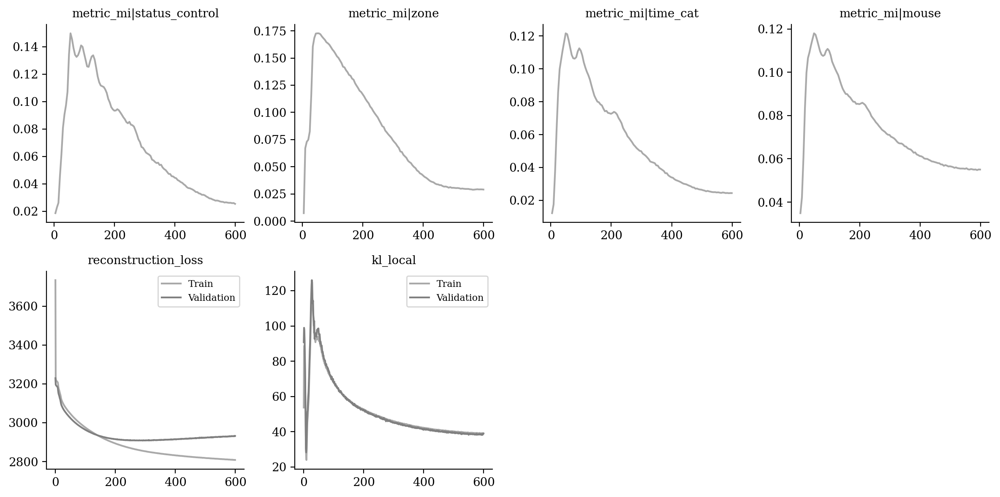

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

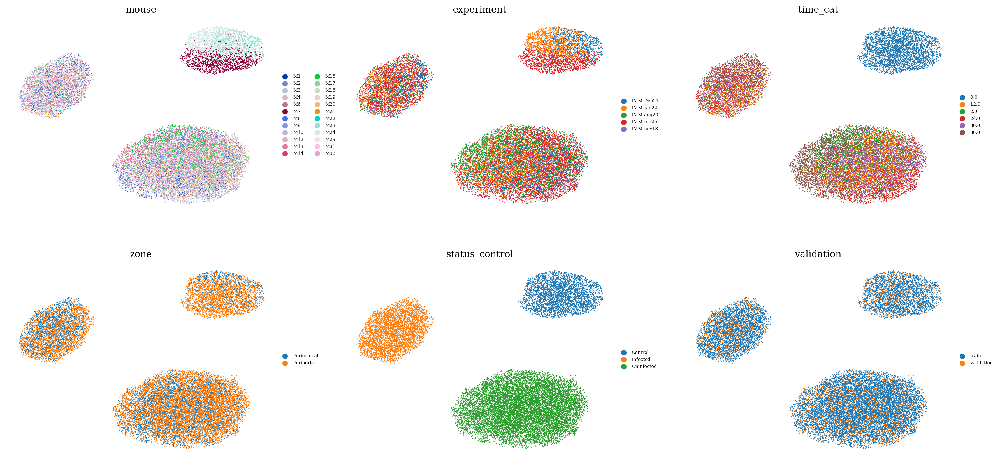

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

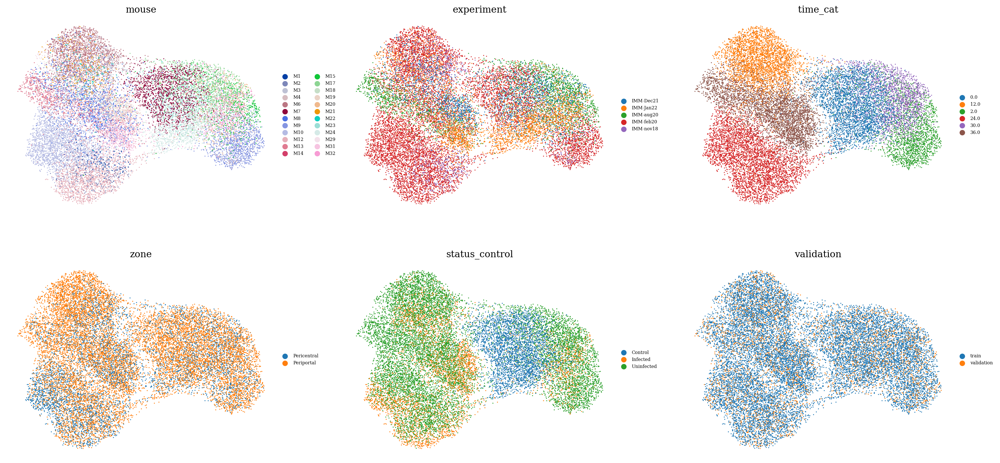

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

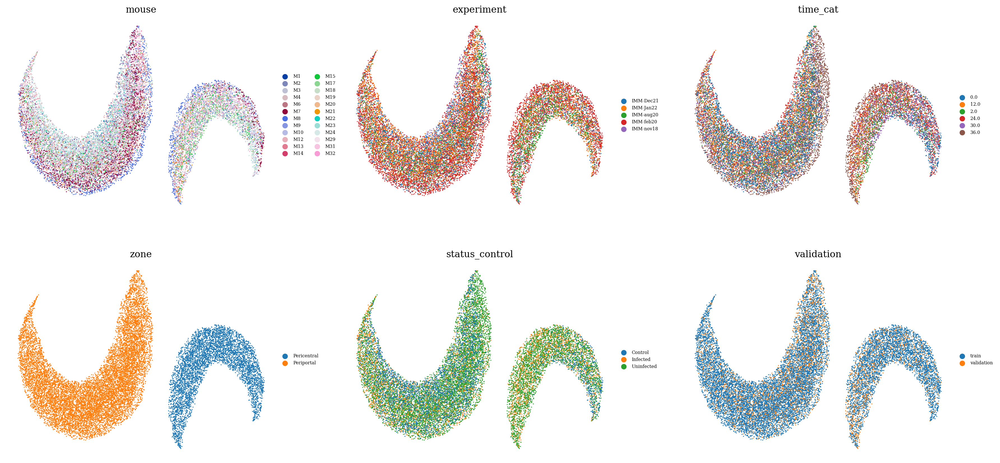

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

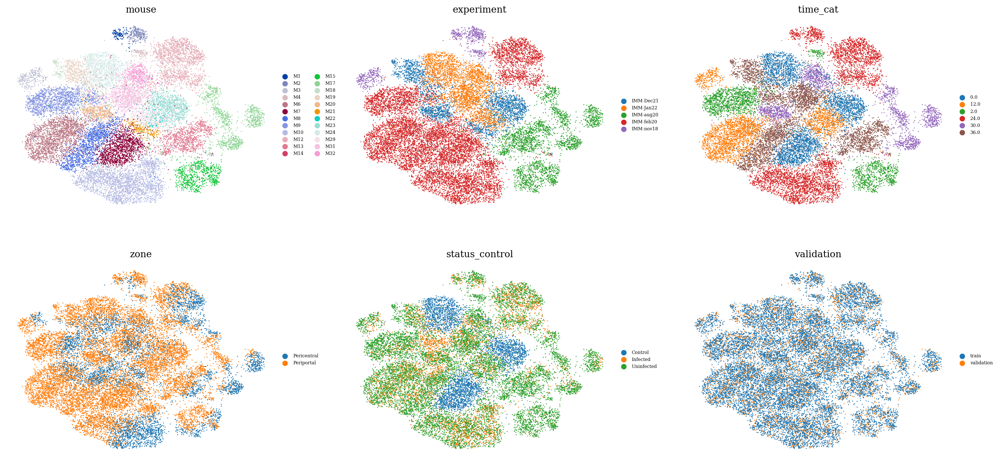

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

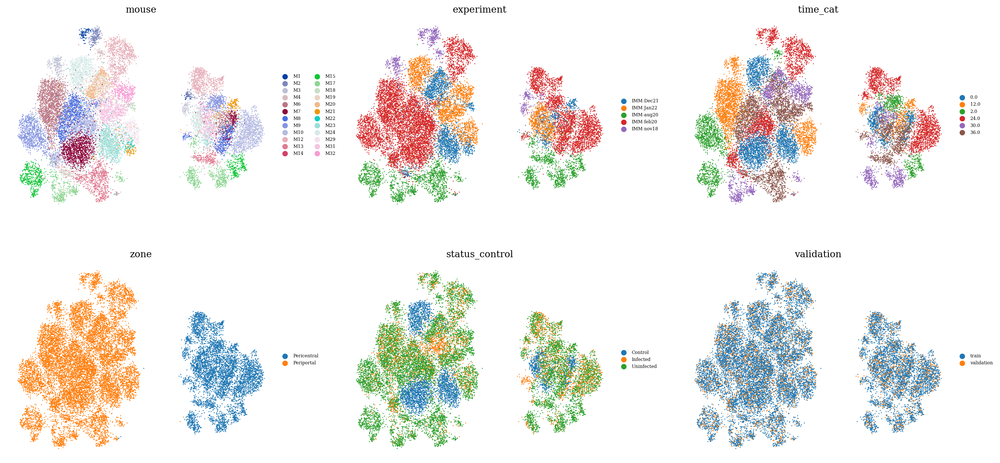

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

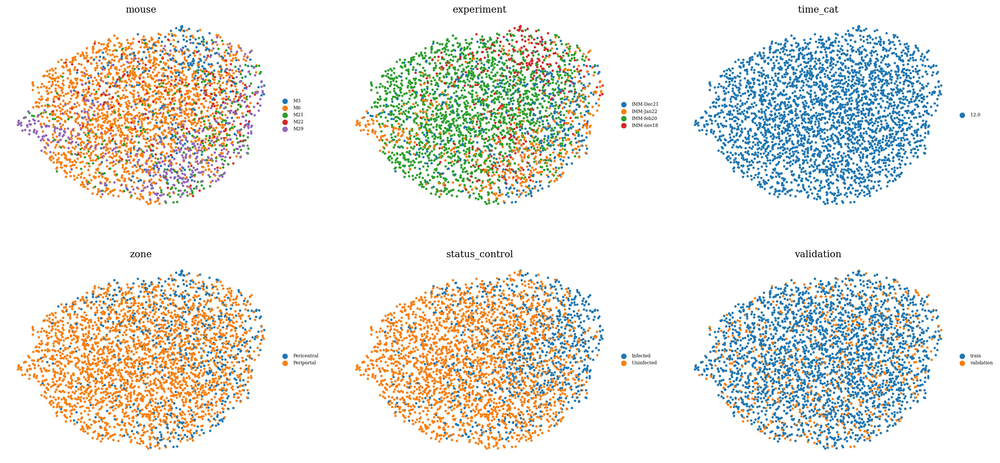

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )